# Loading the Image Paths

In [ ]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

We are using pure Pytorch for this implementation.

# Splitting the data into Training and Validation sets

In [ ]:
if use_colab == True:
  path = coco_path
else:
  path = "/content/drive/MyDrive/coco2017/train2017"
    
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:4000] # choosing the first 4000 as training set
val_idxs = rand_idxs[9000:] # choosing last 1000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

4000 1000


I’m resizing the images and flipping horizontally (flipping only if it is training set) and then I read an RGB image, convert it to Lab color space and separate the first (grayscale) channel and the color channels as my inputs and targets for the models respectively. Then I’m making the data loaders.

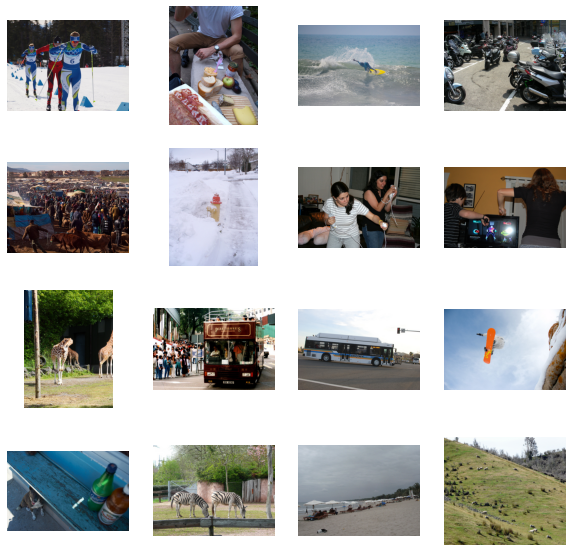

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

Just extracting some parts of the dataset to view the images

# Making Datasets and DataLoaders

In [ ]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
250 63


# Constructing the Generator and U-NET Architecture

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

# Constructing the Discriminator

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

# Patching the Discriminator

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In a patch discriminator, the model outputs one number for every patch of say 70 by 70 pixels of the input image and for each of them decides whether it is fake or not separately. Using such a model for the task of colorization seems reasonable because the local changes that the model needs to make are really important and maybe deciding on the whole image as in vanilla discriminator cannot take care of the subtleties of this task. Here, the model's output shape is 30 by 30 but it does not mean that our patches are 30 by 30. The actual patch size is obtained when you compute the receptive field of each of these 900 (30 multiplied by 30) output numbers which in our case will be 70 by 70.

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

This code implements a model by stacking blocks of Conv-BatchNorm-LeackyReLU to decide whether the input image is fake or real. We can see that the first and last blocks do not use normalization and the last block has no activation function (it is embedded in the loss function)

# Initializing parameters for the GAN Loss Function

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

# Model Initializing

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

We are initializing the weights of our model with a mean of 0.0 and standard deviation of 0.02 which are the proposed hyperparameters

# Combining all the classes together

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

1. In the init we define our generator and discriminator using the previous functions and classes we defined and we also initialize them with init_model function.

2. Then we define our two loss functions and the optimizers of the generator and discriminator.

3. The whole work is being done in optimize method of this class. First and only once per iteration (batch of training set) we call the module's forward method and store the outputs in fake_color variable of the class.

4. Then, we first train the discriminator by using backward_D method in which we feed the fake images produced by generator to the discriminator (make sure to detach them from the generator's graph so that they act as a constant to the discriminator, like normal images) and label them as fake.

5. Then we feed a batch of real images from training set to the discriminator and label them as real. We add up the two losses for fake and real and take the average and then call the backward on the final loss.

6. Now, we can train the generator. In backward_G method we feed the discriminator the fake image and try to fool it by assigning real labels to them and calculating the adversarial loss. We use L1 loss as well and compute the distance between the predicted two channels and the target two channels and multiply this loss by a coefficient (which is 100 in our case) to balance the two losses and then add this loss to the adversarial loss. Then we call the backward method of the loss.

# Utility Functions

These are utility functions to log the losses of our network and also visualize the results during training. 

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

# Training Function

Each epoch takes about 1:24 (1 minute 24 seconds) to load. Batch size is 250 at each iteration. A total of 50 Epochs are trained. As the tarining is being processed the Loss function is decreasing at each epoch showing the accuracy of the model.

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 1/50
Iteration 200/250
loss_D_fake: 0.40808
loss_D_real: 0.42772
loss_D: 0.41790
loss_G_GAN: 1.83545
loss_G_L1: 9.42850
loss_G: 11.26395


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


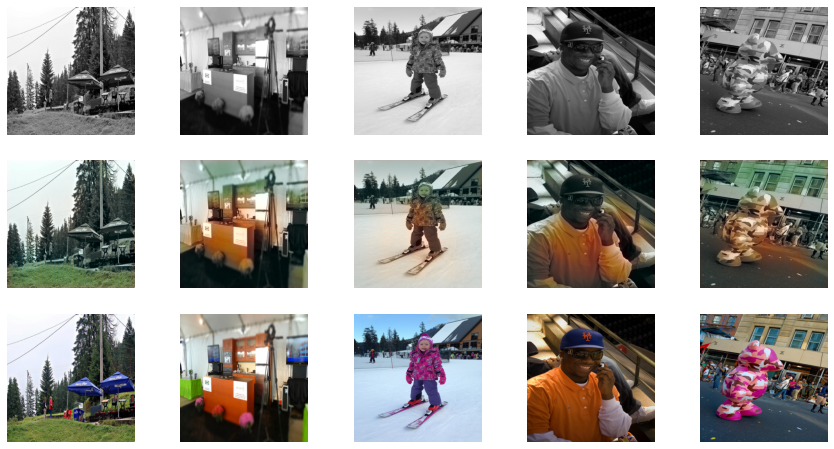

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 2/50
Iteration 200/250
loss_D_fake: 0.46121
loss_D_real: 0.49494
loss_D: 0.47807
loss_G_GAN: 1.61401
loss_G_L1: 10.26844
loss_G: 11.88245


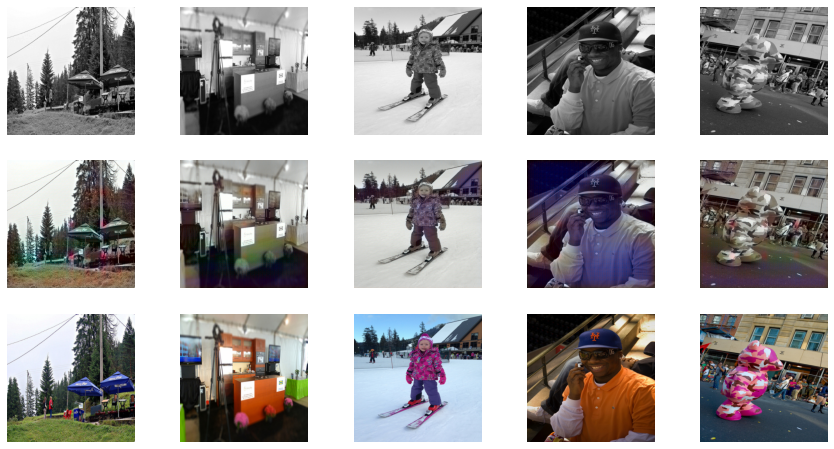

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 3/50
Iteration 200/250
loss_D_fake: 0.49506
loss_D_real: 0.54692
loss_D: 0.52099
loss_G_GAN: 1.40678
loss_G_L1: 10.54715
loss_G: 11.95393


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 55 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 103 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 144 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


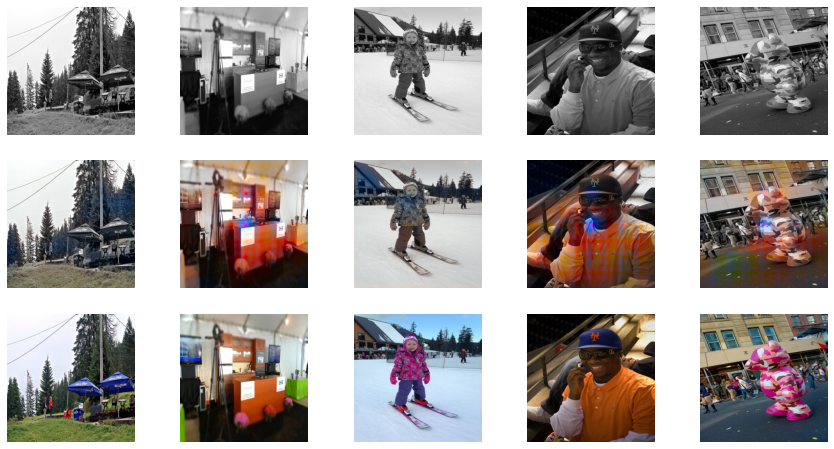

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 4/50
Iteration 200/250
loss_D_fake: 0.51788
loss_D_real: 0.57274
loss_D: 0.54531
loss_G_GAN: 1.31713
loss_G_L1: 10.55946
loss_G: 11.87659


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


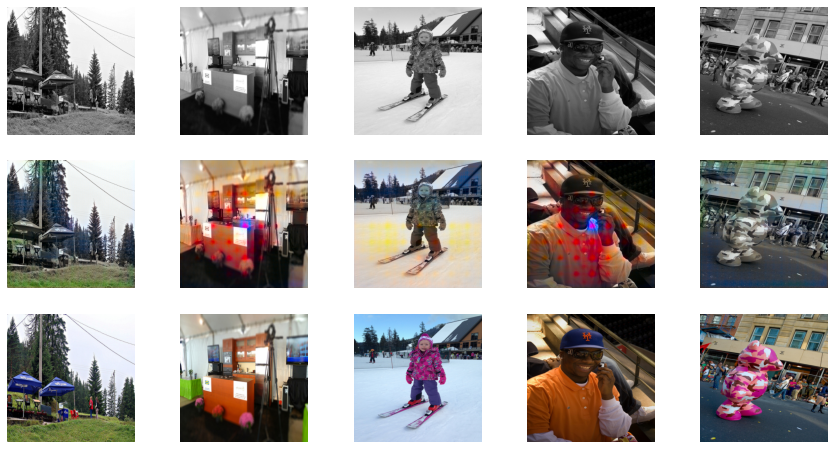

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 5/50
Iteration 200/250
loss_D_fake: 0.52759
loss_D_real: 0.58688
loss_D: 0.55724
loss_G_GAN: 1.26627
loss_G_L1: 10.44769
loss_G: 11.71396


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


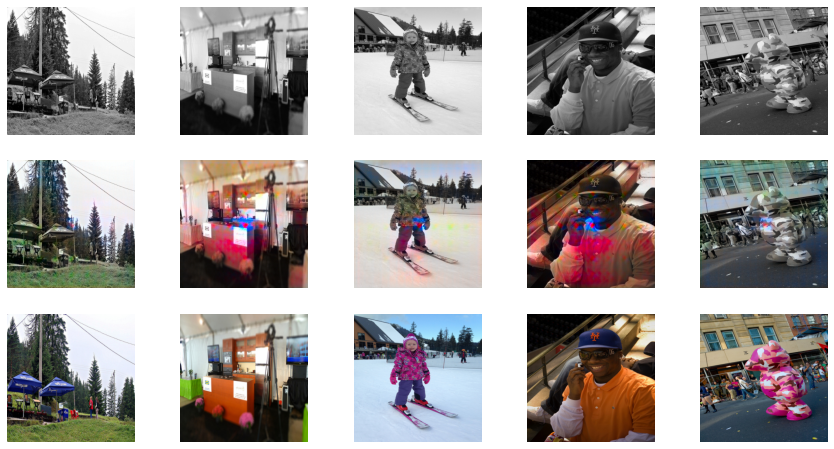

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 6/50
Iteration 200/250
loss_D_fake: 0.51536
loss_D_real: 0.57877
loss_D: 0.54706
loss_G_GAN: 1.25684
loss_G_L1: 10.35237
loss_G: 11.60921


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 42 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color 

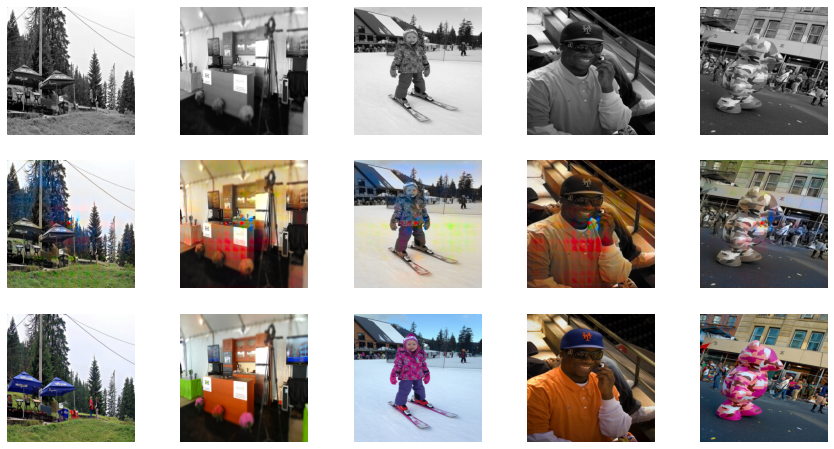

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 7/50
Iteration 200/250
loss_D_fake: 0.51838
loss_D_real: 0.58947
loss_D: 0.55393
loss_G_GAN: 1.24545
loss_G_L1: 10.29033
loss_G: 11.53577


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color 

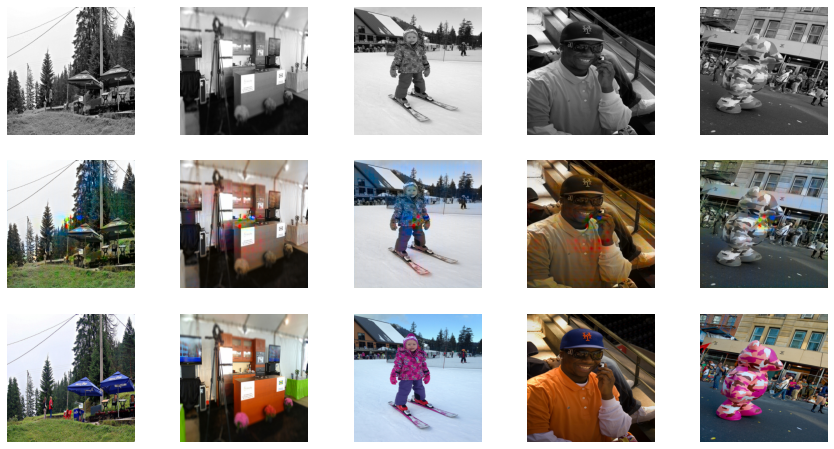

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 8/50
Iteration 200/250
loss_D_fake: 0.52490
loss_D_real: 0.58472
loss_D: 0.55481
loss_G_GAN: 1.23869
loss_G_L1: 10.21416
loss_G: 11.45286


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


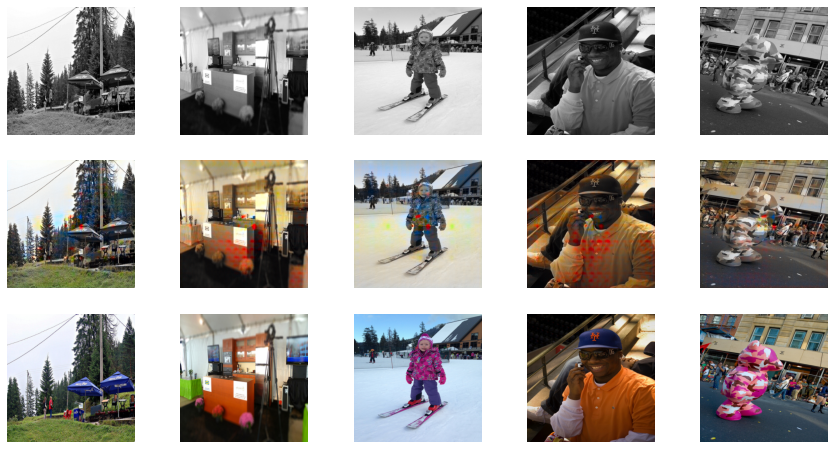

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 9/50
Iteration 200/250
loss_D_fake: 0.52306
loss_D_real: 0.57806
loss_D: 0.55056
loss_G_GAN: 1.23930
loss_G_L1: 10.15739
loss_G: 11.39670


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


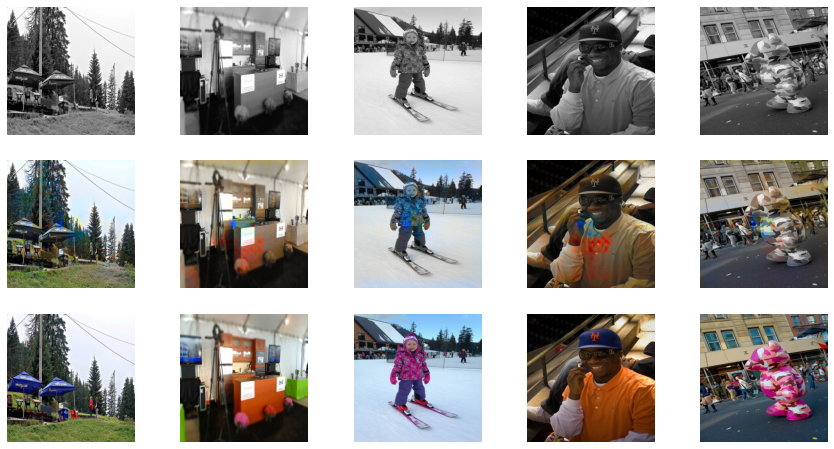

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 10/50
Iteration 200/250
loss_D_fake: 0.52577
loss_D_real: 0.58899
loss_D: 0.55738
loss_G_GAN: 1.21678
loss_G_L1: 10.10334
loss_G: 11.32011


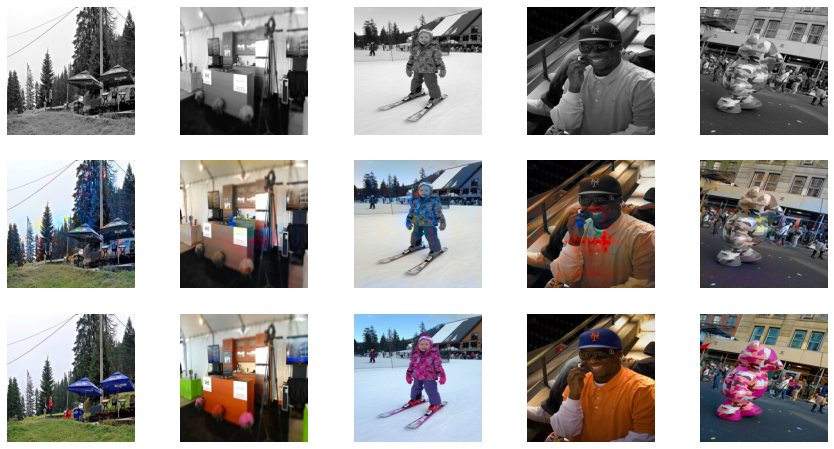

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 11/50
Iteration 200/250
loss_D_fake: 0.52741
loss_D_real: 0.58632
loss_D: 0.55686
loss_G_GAN: 1.22802
loss_G_L1: 10.03846
loss_G: 11.26648


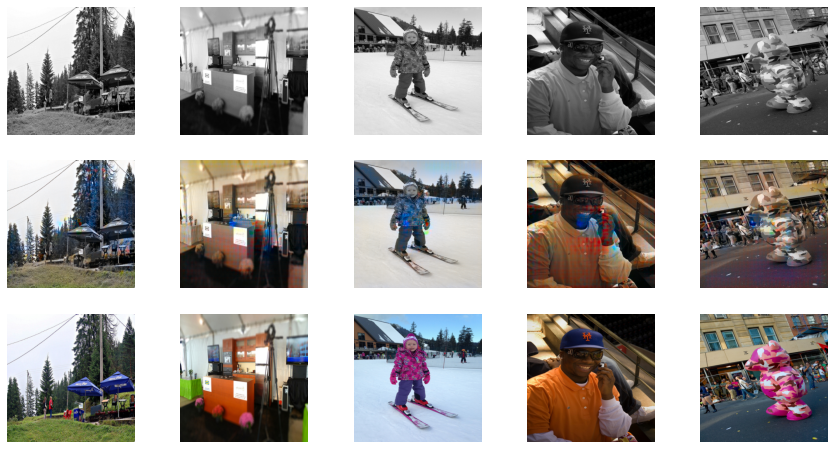

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 12/50
Iteration 200/250
loss_D_fake: 0.53354
loss_D_real: 0.59436
loss_D: 0.56395
loss_G_GAN: 1.21279
loss_G_L1: 9.93850
loss_G: 11.15130


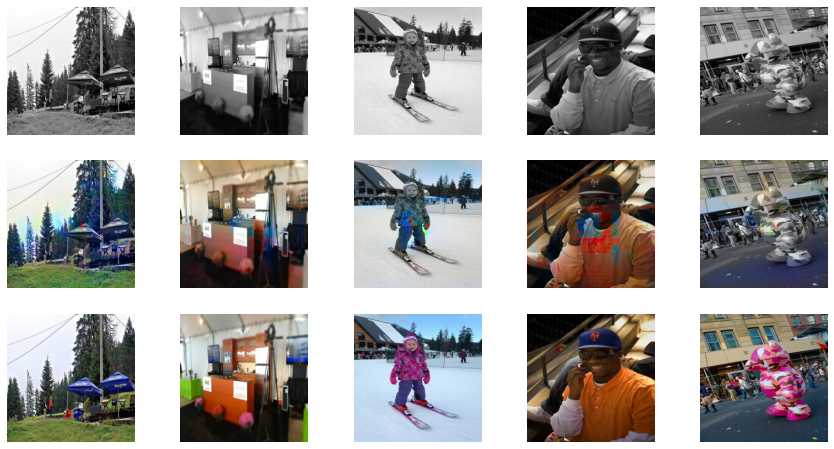

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 13/50
Iteration 200/250
loss_D_fake: 0.53040
loss_D_real: 0.59398
loss_D: 0.56219
loss_G_GAN: 1.19628
loss_G_L1: 9.85833
loss_G: 11.05462


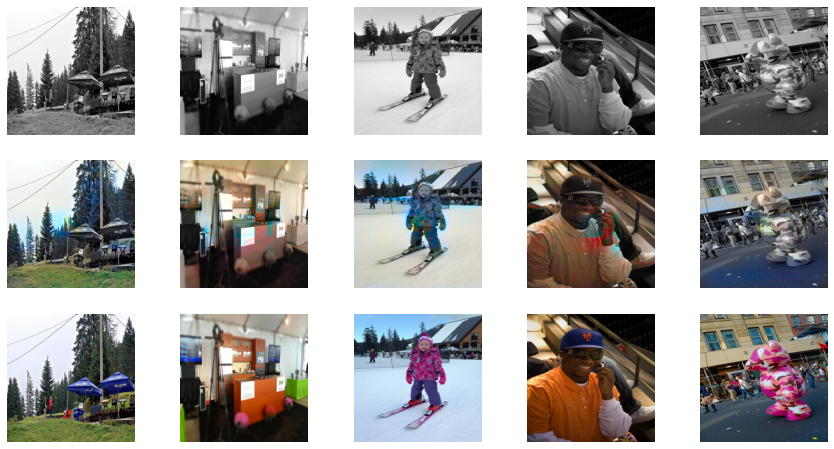

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 14/50
Iteration 200/250
loss_D_fake: 0.53802
loss_D_real: 0.60228
loss_D: 0.57015
loss_G_GAN: 1.20520
loss_G_L1: 9.74661
loss_G: 10.95181


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 67 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 83 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 77 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


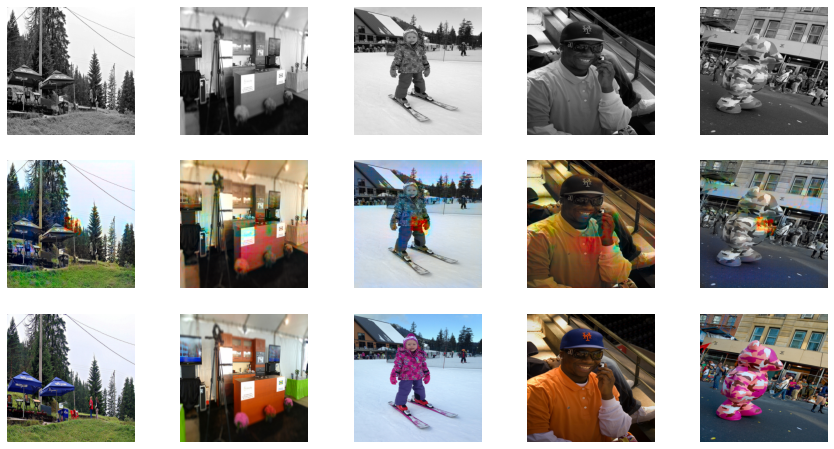

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 15/50
Iteration 200/250
loss_D_fake: 0.54051
loss_D_real: 0.59522
loss_D: 0.56786
loss_G_GAN: 1.19459
loss_G_L1: 9.63798
loss_G: 10.83257


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


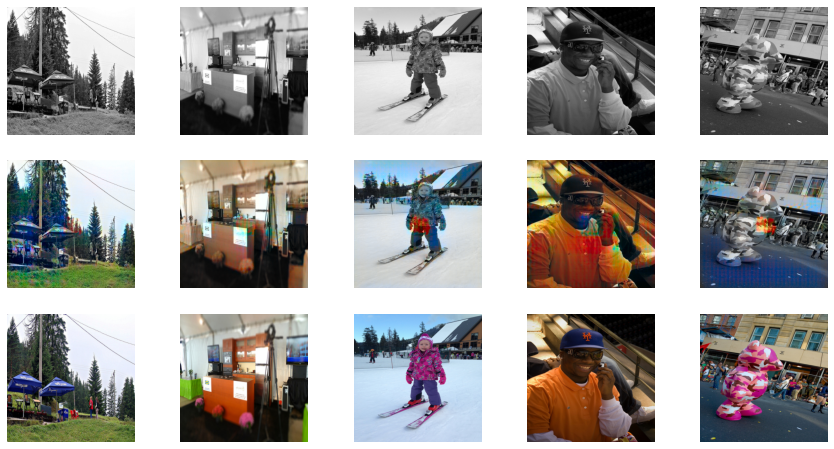

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 16/50
Iteration 200/250
loss_D_fake: 0.53584
loss_D_real: 0.59276
loss_D: 0.56430
loss_G_GAN: 1.19964
loss_G_L1: 9.54838
loss_G: 10.74802


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 489 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 114 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Col

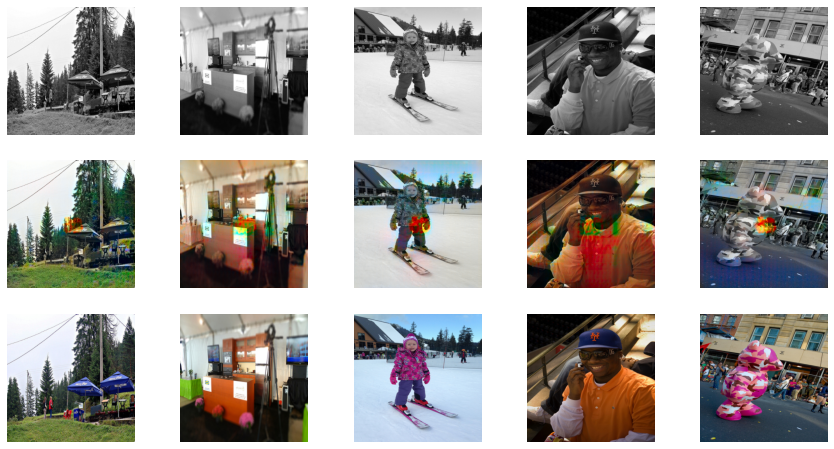

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 17/50
Iteration 200/250
loss_D_fake: 0.53129
loss_D_real: 0.58759
loss_D: 0.55944
loss_G_GAN: 1.21153
loss_G_L1: 9.40859
loss_G: 10.62012


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 105 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 139 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


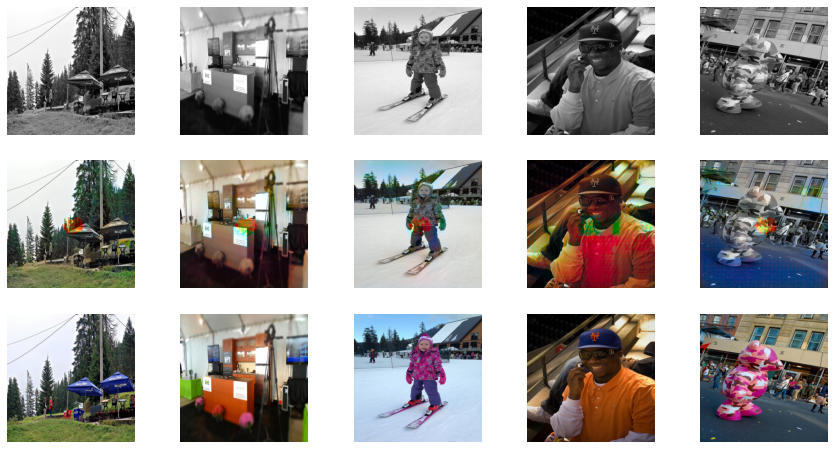

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 18/50
Iteration 200/250
loss_D_fake: 0.52716
loss_D_real: 0.57900
loss_D: 0.55308
loss_G_GAN: 1.22603
loss_G_L1: 9.32451
loss_G: 10.55054


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 106 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 158 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 304 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


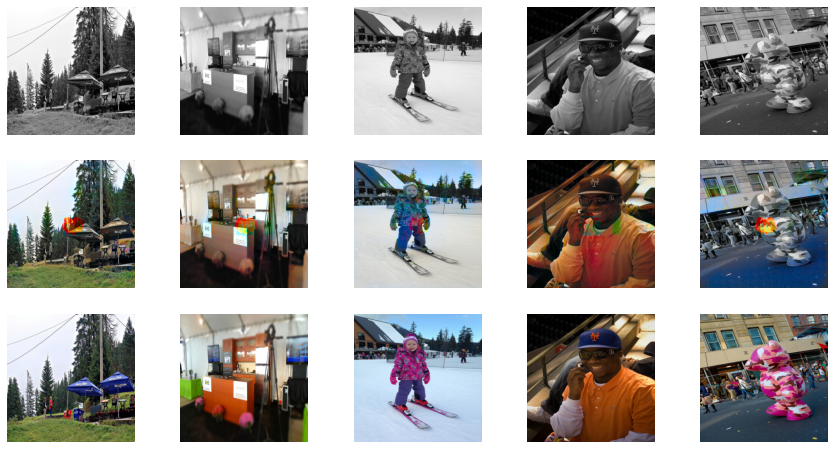

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 19/50
Iteration 200/250
loss_D_fake: 0.52844
loss_D_real: 0.58210
loss_D: 0.55527
loss_G_GAN: 1.25778
loss_G_L1: 9.20941
loss_G: 10.46719


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 98 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


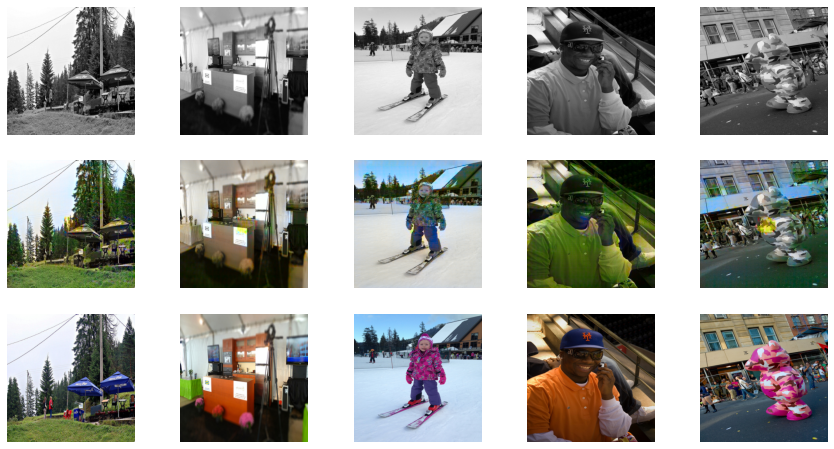

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 20/50
Iteration 200/250
loss_D_fake: 0.52453
loss_D_real: 0.57207
loss_D: 0.54830
loss_G_GAN: 1.25072
loss_G_L1: 9.07920
loss_G: 10.32992


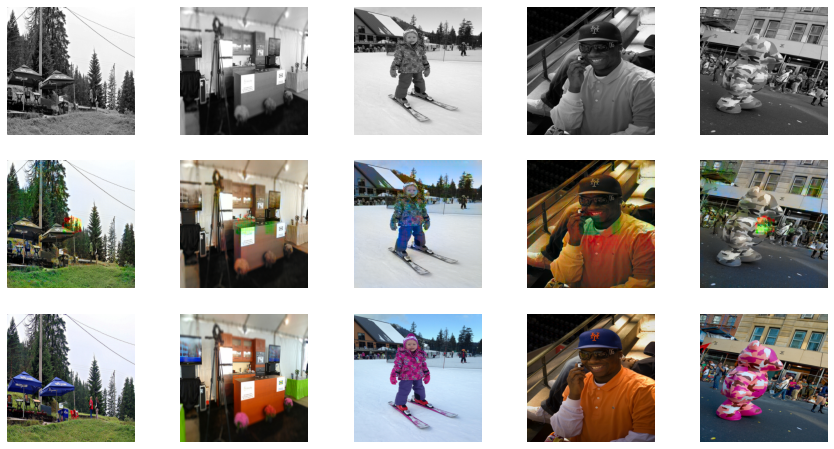

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 21/50
Iteration 200/250
loss_D_fake: 0.52505
loss_D_real: 0.57438
loss_D: 0.54972
loss_G_GAN: 1.25756
loss_G_L1: 8.98133
loss_G: 10.23890


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 76 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


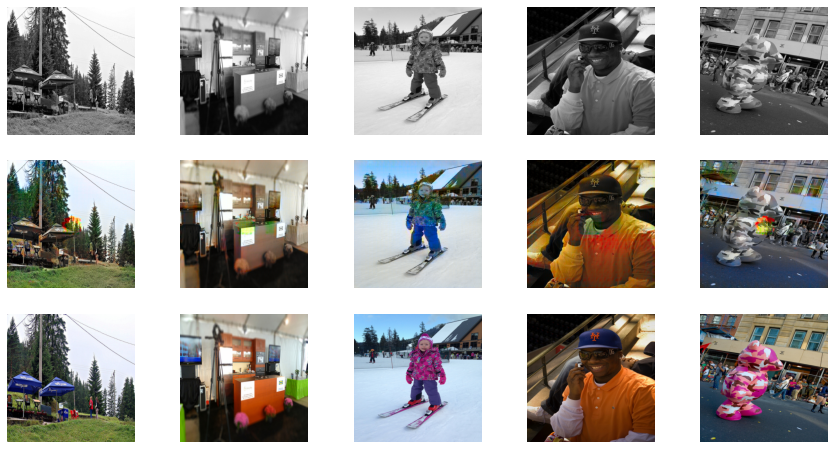

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 22/50
Iteration 200/250
loss_D_fake: 0.52410
loss_D_real: 0.57766
loss_D: 0.55088
loss_G_GAN: 1.26757
loss_G_L1: 8.91280
loss_G: 10.18038


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 84 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 66 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 92 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


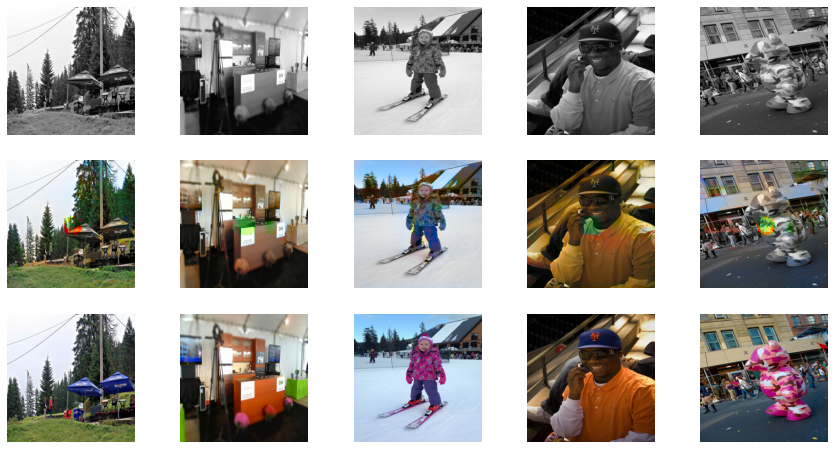

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 23/50
Iteration 200/250
loss_D_fake: 0.51971
loss_D_real: 0.57079
loss_D: 0.54525
loss_G_GAN: 1.25567
loss_G_L1: 8.76729
loss_G: 10.02296


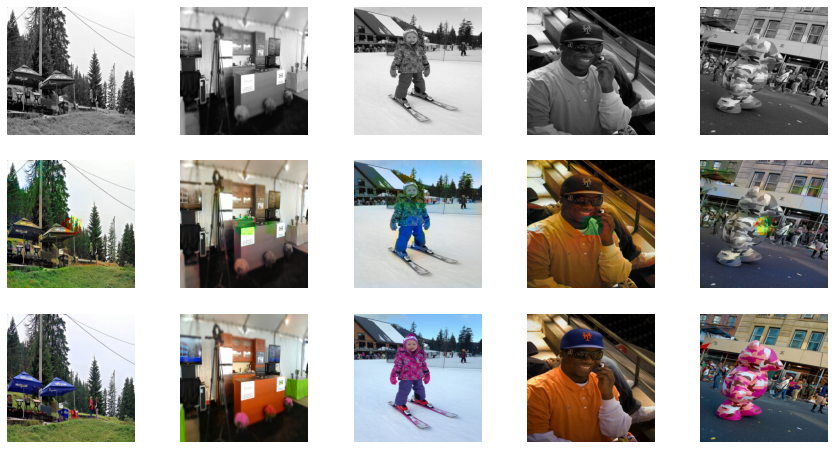

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 24/50
Iteration 200/250
loss_D_fake: 0.53068
loss_D_real: 0.58034
loss_D: 0.55551
loss_G_GAN: 1.26739
loss_G_L1: 8.65175
loss_G: 9.91914


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


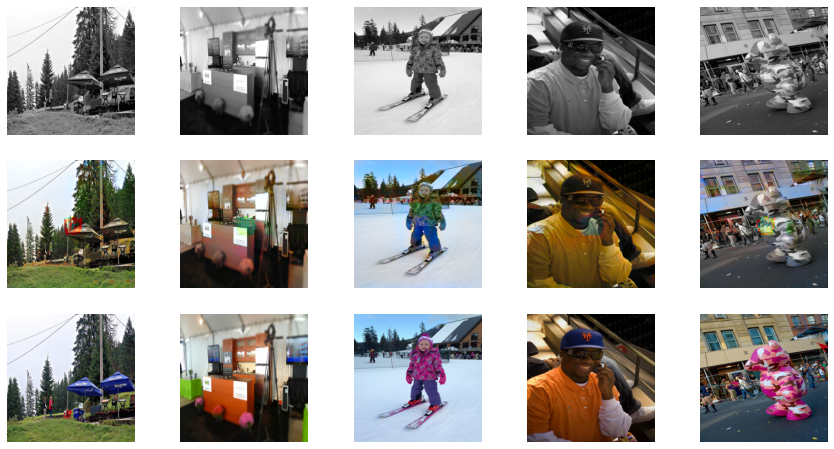

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 25/50
Iteration 200/250
loss_D_fake: 0.52549
loss_D_real: 0.57160
loss_D: 0.54854
loss_G_GAN: 1.25612
loss_G_L1: 8.59031
loss_G: 9.84643


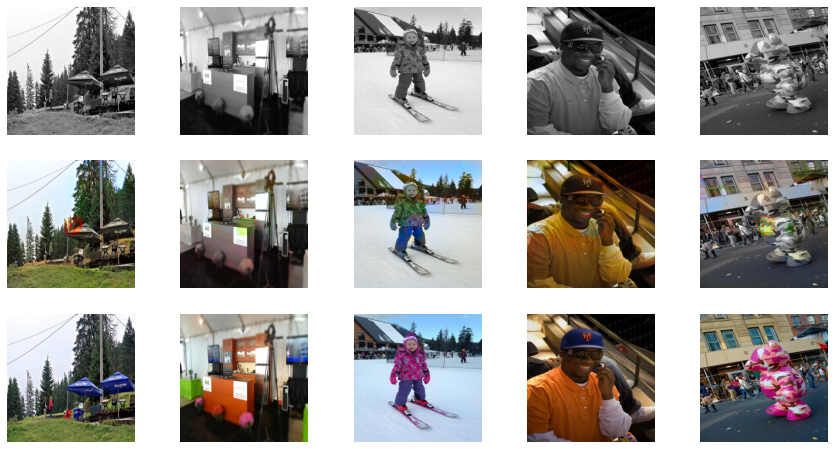

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 26/50
Iteration 200/250
loss_D_fake: 0.52228
loss_D_real: 0.56606
loss_D: 0.54417
loss_G_GAN: 1.25304
loss_G_L1: 8.45813
loss_G: 9.71117


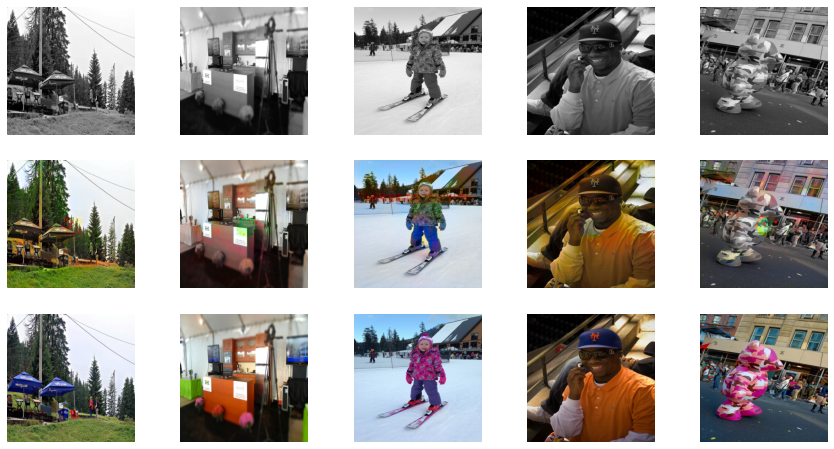

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 27/50
Iteration 200/250
loss_D_fake: 0.53556
loss_D_real: 0.56968
loss_D: 0.55262
loss_G_GAN: 1.26505
loss_G_L1: 8.33217
loss_G: 9.59722


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


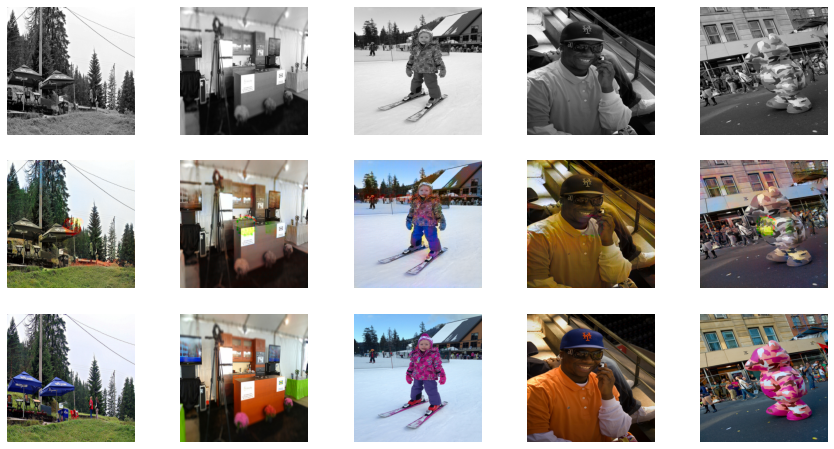

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 28/50
Iteration 200/250
loss_D_fake: 0.53410
loss_D_real: 0.56838
loss_D: 0.55124
loss_G_GAN: 1.24479
loss_G_L1: 8.22528
loss_G: 9.47007


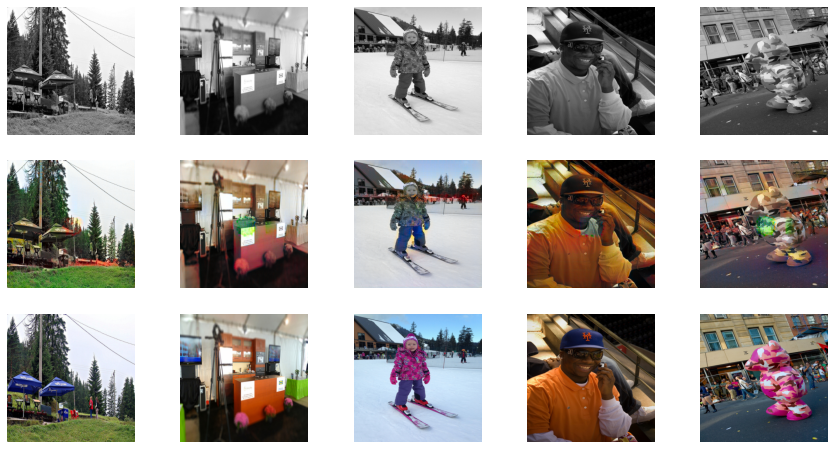

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 29/50
Iteration 200/250
loss_D_fake: 0.53122
loss_D_real: 0.56659
loss_D: 0.54891
loss_G_GAN: 1.24965
loss_G_L1: 8.17867
loss_G: 9.42832


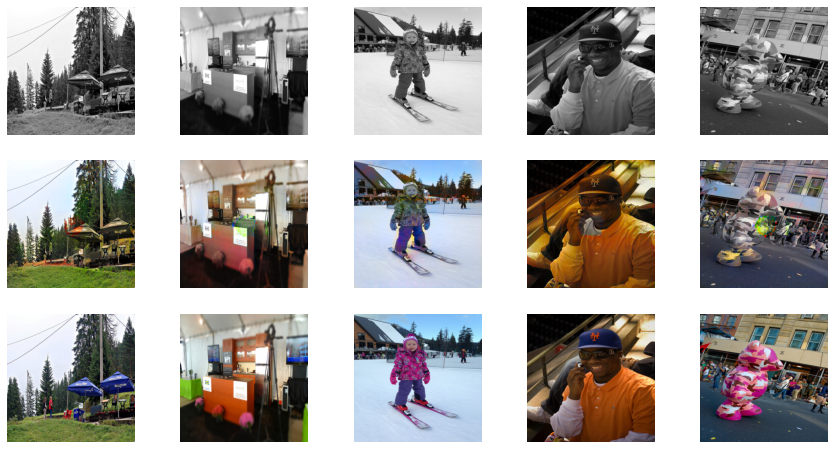

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 30/50
Iteration 200/250
loss_D_fake: 0.54107
loss_D_real: 0.56912
loss_D: 0.55510
loss_G_GAN: 1.24951
loss_G_L1: 8.02941
loss_G: 9.27892


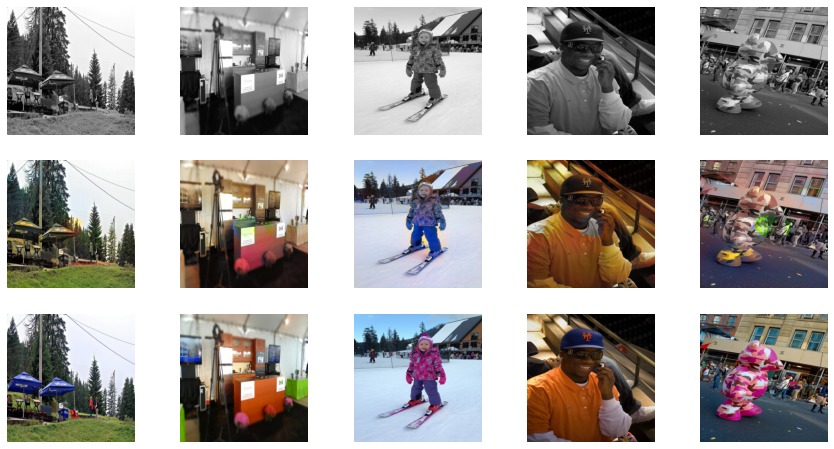

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 31/50
Iteration 200/250
loss_D_fake: 0.53670
loss_D_real: 0.56391
loss_D: 0.55031
loss_G_GAN: 1.24272
loss_G_L1: 7.91869
loss_G: 9.16141


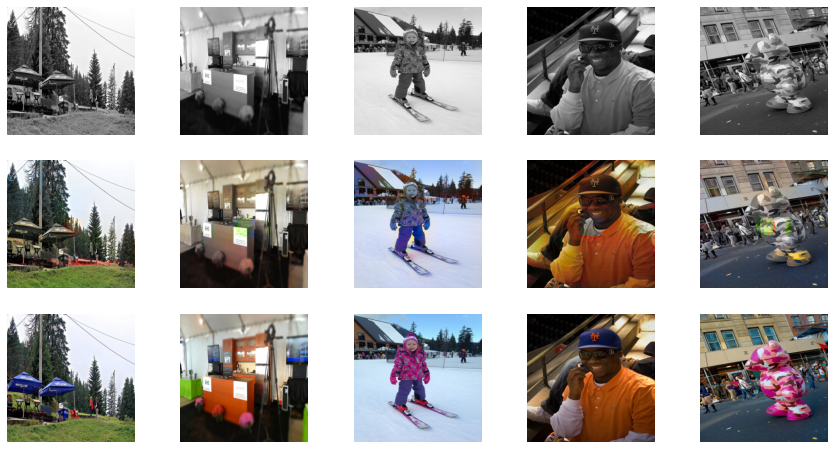

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 32/50
Iteration 200/250
loss_D_fake: 0.54282
loss_D_real: 0.56518
loss_D: 0.55400
loss_G_GAN: 1.25390
loss_G_L1: 7.78309
loss_G: 9.03699


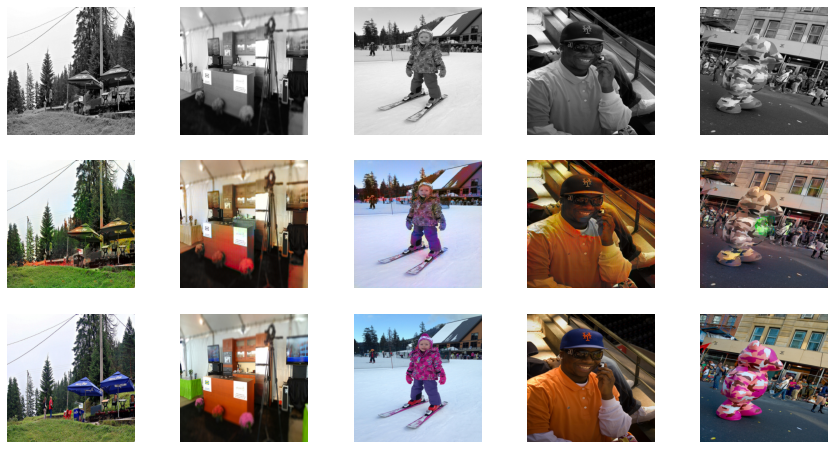

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 33/50
Iteration 200/250
loss_D_fake: 0.55005
loss_D_real: 0.56810
loss_D: 0.55908
loss_G_GAN: 1.25224
loss_G_L1: 7.68319
loss_G: 8.93543


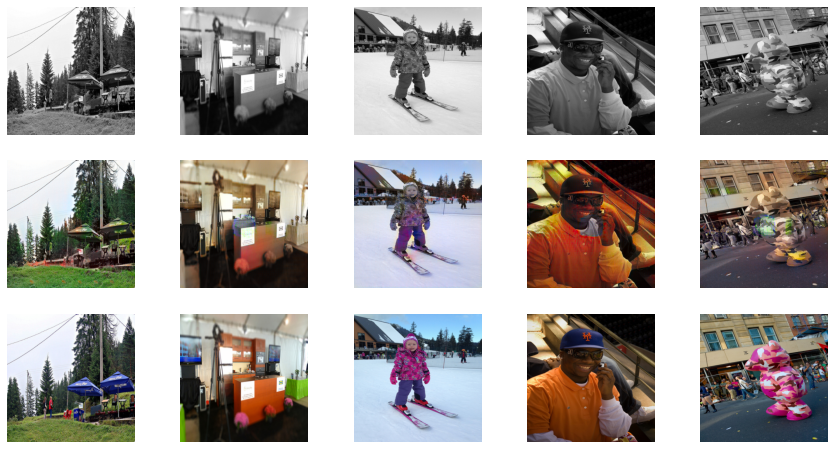

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 34/50
Iteration 200/250
loss_D_fake: 0.54301
loss_D_real: 0.56084
loss_D: 0.55192
loss_G_GAN: 1.23736
loss_G_L1: 7.60724
loss_G: 8.84461


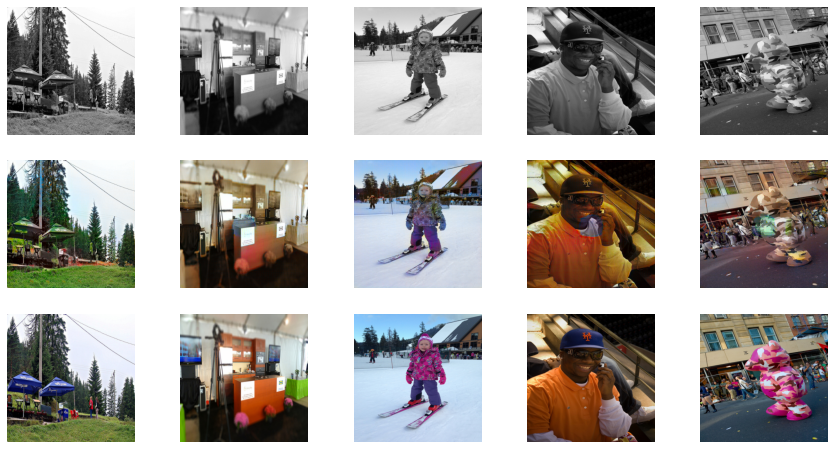

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 35/50
Iteration 200/250
loss_D_fake: 0.54749
loss_D_real: 0.55711
loss_D: 0.55230
loss_G_GAN: 1.23831
loss_G_L1: 7.46895
loss_G: 8.70726


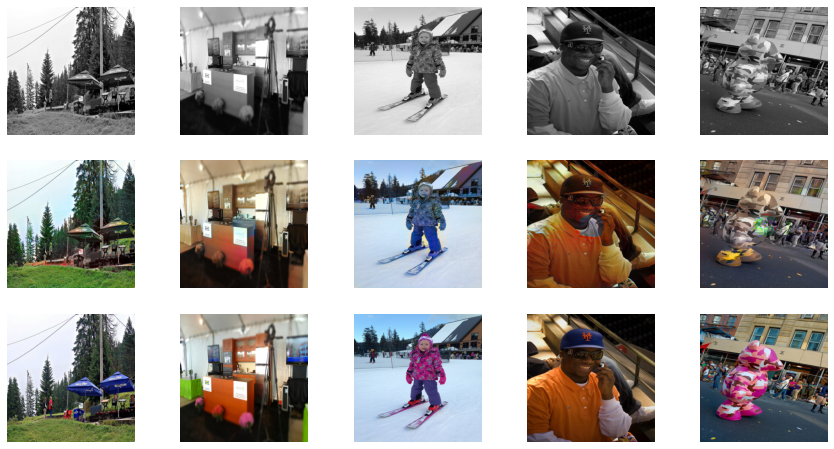

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 36/50
Iteration 200/250
loss_D_fake: 0.55122
loss_D_real: 0.56766
loss_D: 0.55944
loss_G_GAN: 1.24954
loss_G_L1: 7.40624
loss_G: 8.65578


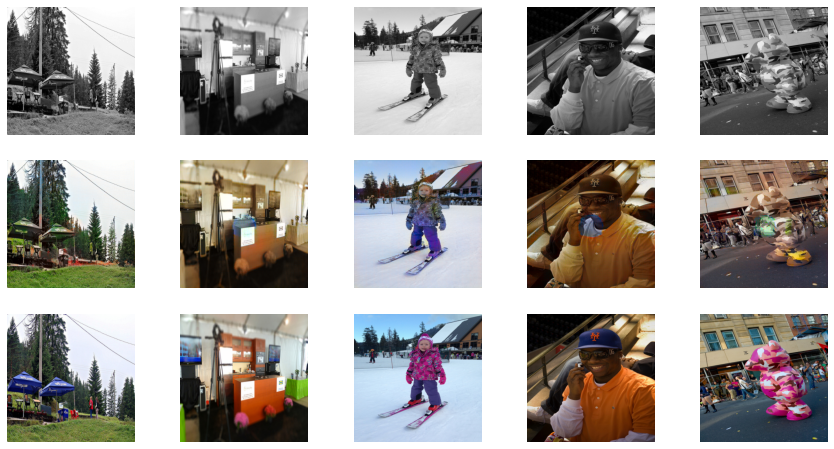

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 37/50
Iteration 200/250
loss_D_fake: 0.55117
loss_D_real: 0.56649
loss_D: 0.55883
loss_G_GAN: 1.24059
loss_G_L1: 7.35267
loss_G: 8.59325


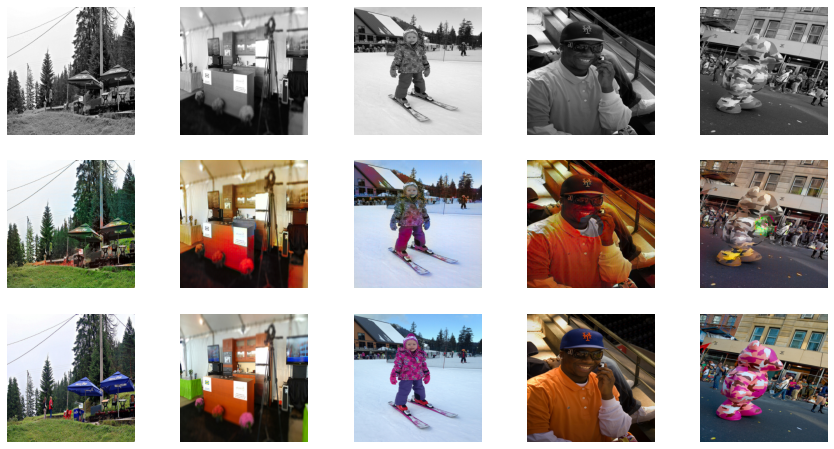

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 38/50
Iteration 200/250
loss_D_fake: 0.54851
loss_D_real: 0.56222
loss_D: 0.55536
loss_G_GAN: 1.22492
loss_G_L1: 7.28094
loss_G: 8.50586


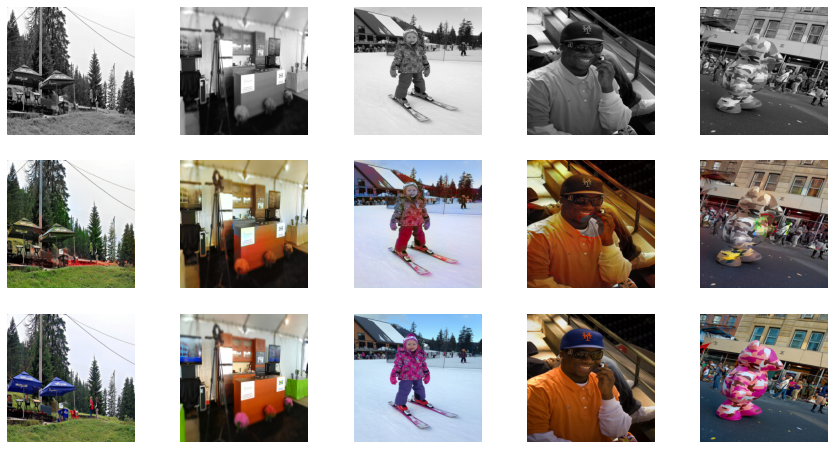

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 39/50
Iteration 200/250
loss_D_fake: 0.55096
loss_D_real: 0.56396
loss_D: 0.55746
loss_G_GAN: 1.23175
loss_G_L1: 7.19387
loss_G: 8.42562


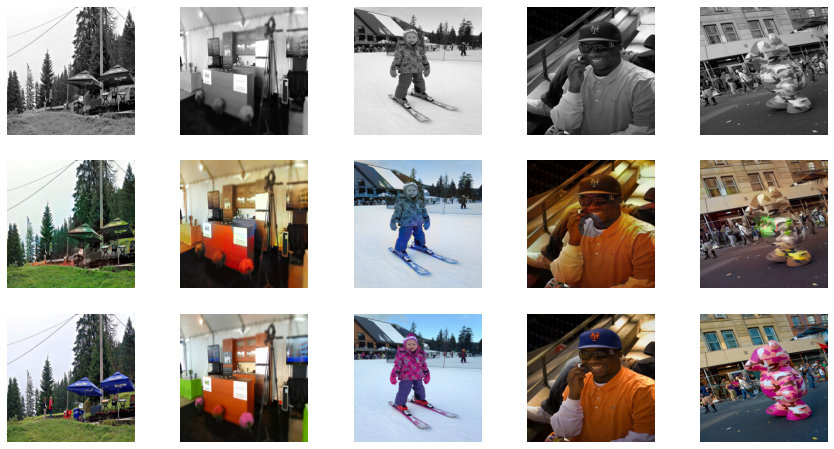

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 40/50
Iteration 200/250
loss_D_fake: 0.55149
loss_D_real: 0.55996
loss_D: 0.55573
loss_G_GAN: 1.22565
loss_G_L1: 7.16000
loss_G: 8.38564


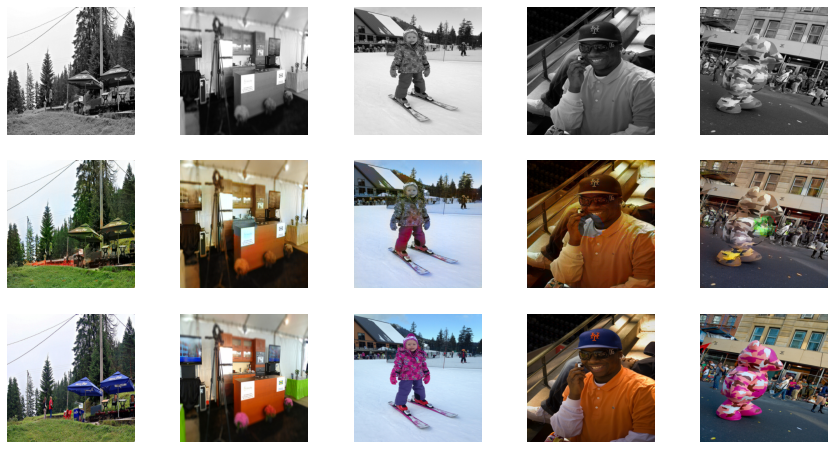

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 41/50
Iteration 200/250
loss_D_fake: 0.54923
loss_D_real: 0.56038
loss_D: 0.55480
loss_G_GAN: 1.24066
loss_G_L1: 7.03999
loss_G: 8.28064


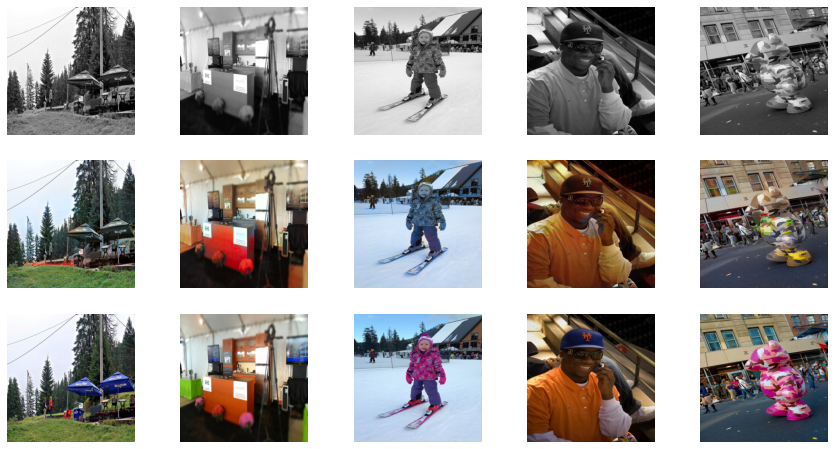

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 42/50
Iteration 200/250
loss_D_fake: 0.54382
loss_D_real: 0.55505
loss_D: 0.54944
loss_G_GAN: 1.22713
loss_G_L1: 6.94862
loss_G: 8.17575


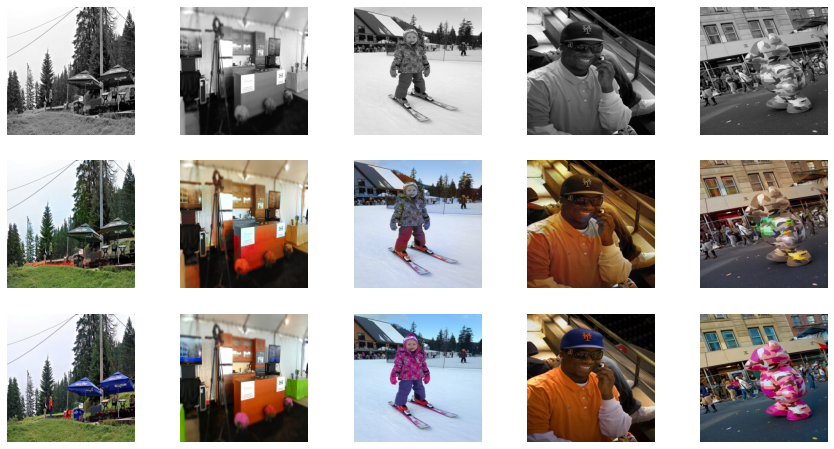

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 43/50
Iteration 200/250
loss_D_fake: 0.56103
loss_D_real: 0.56713
loss_D: 0.56408
loss_G_GAN: 1.23448
loss_G_L1: 6.84062
loss_G: 8.07510


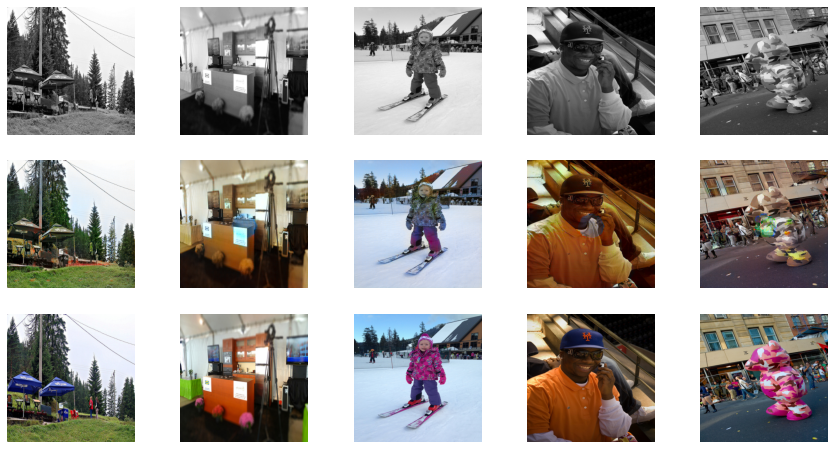

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 44/50
Iteration 200/250
loss_D_fake: 0.55066
loss_D_real: 0.56275
loss_D: 0.55670
loss_G_GAN: 1.21526
loss_G_L1: 6.82248
loss_G: 8.03773


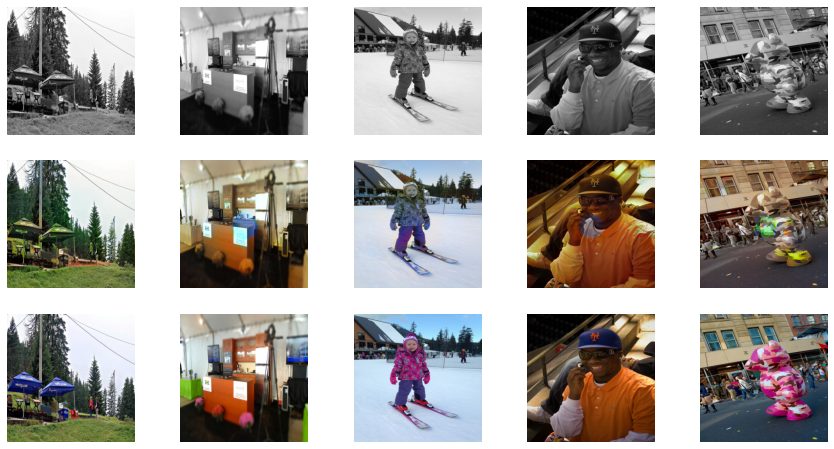

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 45/50
Iteration 200/250
loss_D_fake: 0.54652
loss_D_real: 0.56075
loss_D: 0.55363
loss_G_GAN: 1.22189
loss_G_L1: 6.75917
loss_G: 7.98107


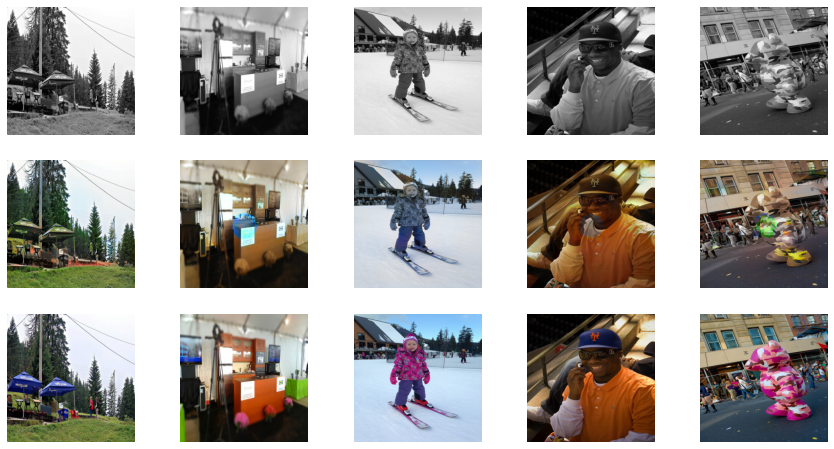

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 46/50
Iteration 200/250
loss_D_fake: 0.54808
loss_D_real: 0.55575
loss_D: 0.55192
loss_G_GAN: 1.21271
loss_G_L1: 6.71717
loss_G: 7.92988


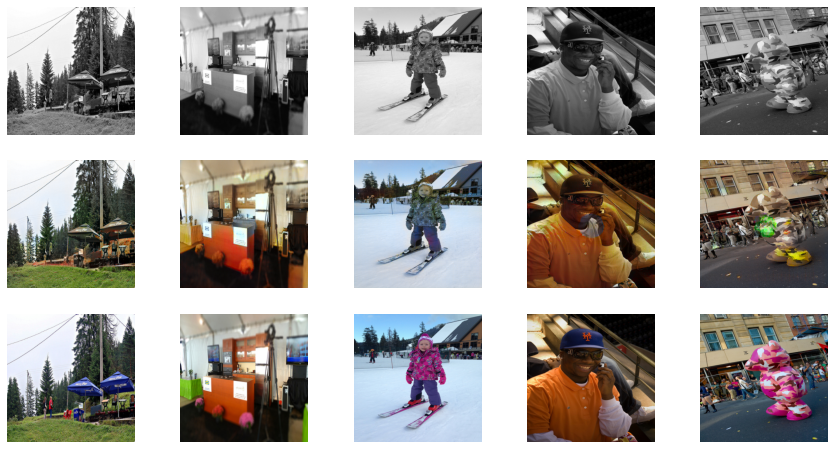

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 47/50
Iteration 200/250
loss_D_fake: 0.54675
loss_D_real: 0.55724
loss_D: 0.55199
loss_G_GAN: 1.21276
loss_G_L1: 6.61032
loss_G: 7.82308


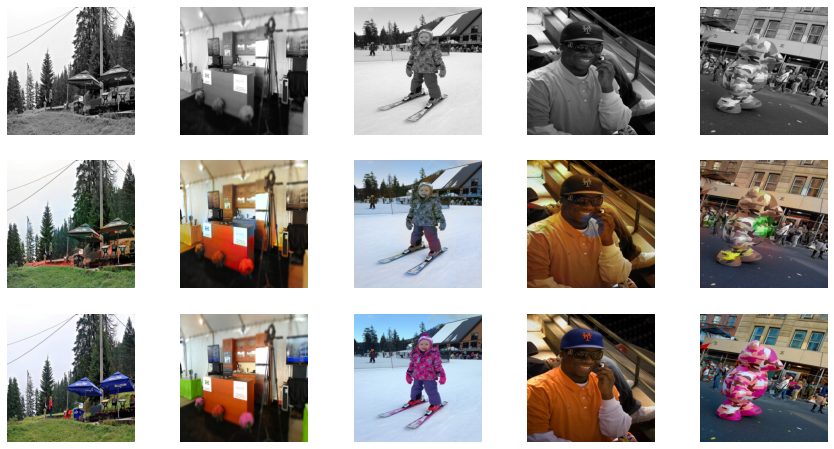

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 48/50
Iteration 200/250
loss_D_fake: 0.55178
loss_D_real: 0.55811
loss_D: 0.55494
loss_G_GAN: 1.22062
loss_G_L1: 6.54015
loss_G: 7.76077


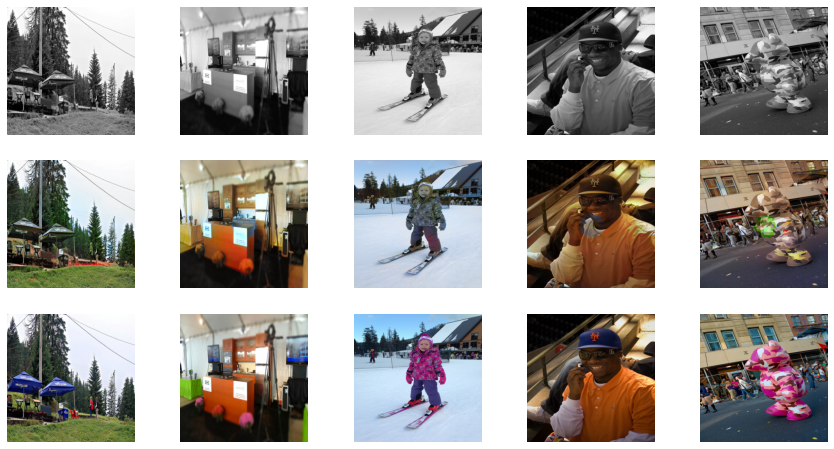

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 49/50
Iteration 200/250
loss_D_fake: 0.55707
loss_D_real: 0.55773
loss_D: 0.55740
loss_G_GAN: 1.22346
loss_G_L1: 6.47843
loss_G: 7.70189


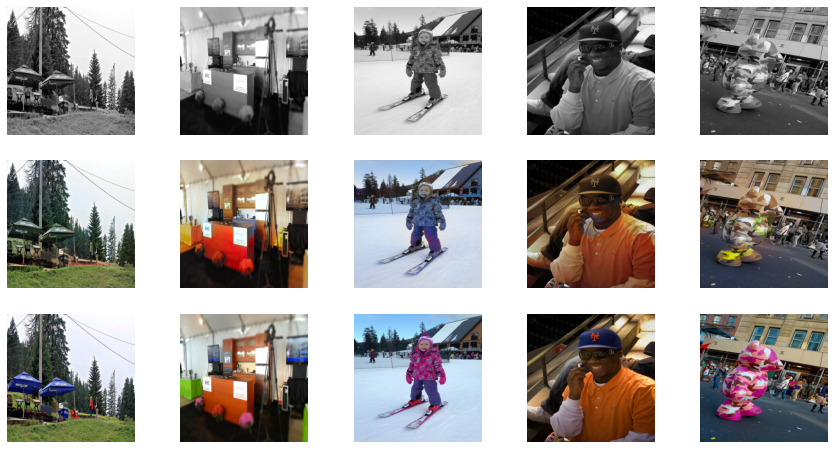

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 50/50
Iteration 200/250
loss_D_fake: 0.55053
loss_D_real: 0.55889
loss_D: 0.55471
loss_G_GAN: 1.22825
loss_G_L1: 6.42693
loss_G: 7.65519


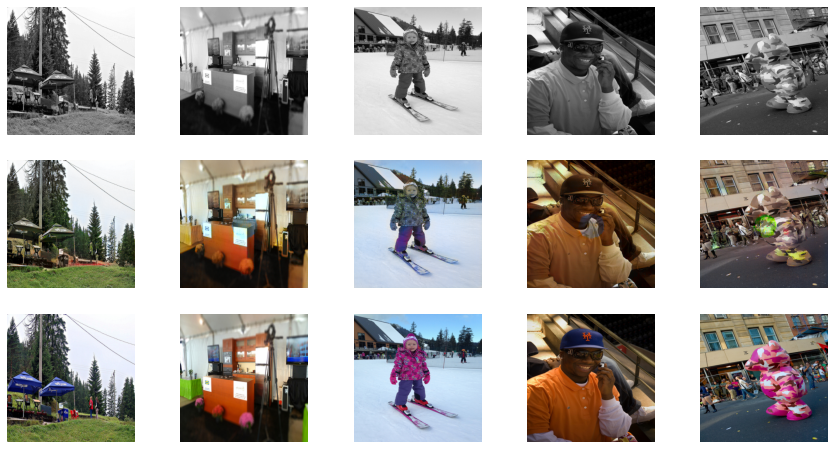

In [ ]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 50)

# Downloading fastai framework to construct the Dynamic U-net architecture

In [ ]:
!pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

     |████████████████████████████████| 187 kB 4.3 MB/s 
     |████████████████████████████████| 831.4 MB 6.4 kB/s 
     |████████████████████████████████| 55 kB 4.6 MB/s 
     |████████████████████████████████| 21.0 MB 258 kB/s 
     |████████████████████████████████| 23.2 MB 1.3 MB/s 
     |████████████████████████████████| 23.3 MB 618 kB/s 
     |████████████████████████████████| 23.3 MB 1.3 MB/s 
     |████████████████████████████████| 22.1 MB 1.3 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.10.0+cu111
    Uninstalling torch-1.10.0+cu111:
      Successfully uninstalled torch-1.10.0+cu111
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.11.1+cu111
    Uninstalling torchvision-0.11.1+cu111:
      Successfully uninstalled torchvision-0.11.1+cu111
  Attempting uninstall: fastai
    Found existing installation: fastai 1.0.61
    Uninstalling fastai-1.0.61:
      Successfully uninstalled fastai-1.0.61
ERROR: pip's dependen

# Constructing a new Generator

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

create_body function loads the pretrained weights of the ResNet18 architecture and cuts the model to remove the last two layers (GlobalAveragePooling and a Linear layer for the ImageNet classification task). 
Then, DynamicUnet uses this backbone to build a U-Net with the needed output channels (2 in our case) and with an input size of 256.

# Pretraining the generator for the colorization task

With this simple function, we pretrain the generator for 20 epochs and then we save its weights. We are training the model again as before using the pretrained weights.

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "res18-unet.pt")

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 1/20
L1 Loss: 0.09359


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 2/20
L1 Loss: 0.08309


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 3/20
L1 Loss: 0.08144


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 4/20
L1 Loss: 0.08036


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 5/20
L1 Loss: 0.07967


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 6/20
L1 Loss: 0.07875


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 7/20
L1 Loss: 0.07761


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 8/20
L1 Loss: 0.07674


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 9/20
L1 Loss: 0.07584


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 10/20
L1 Loss: 0.07475


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 11/20
L1 Loss: 0.07423


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 12/20
L1 Loss: 0.07356


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 13/20
L1 Loss: 0.07271


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 14/20
L1 Loss: 0.07168


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 15/20
L1 Loss: 0.07086


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 16/20
L1 Loss: 0.07038


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 17/20
L1 Loss: 0.06995


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 18/20
L1 Loss: 0.06858


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 19/20
L1 Loss: 0.06799


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 20/20
L1 Loss: 0.06709


model initialized with norm initialization


  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 1/20
Iteration 200/250
loss_D_fake: 0.65510
loss_D_real: 0.64836
loss_D: 0.65173
loss_G_GAN: 0.94570
loss_G_L1: 7.97397
loss_G: 8.91968


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 145 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


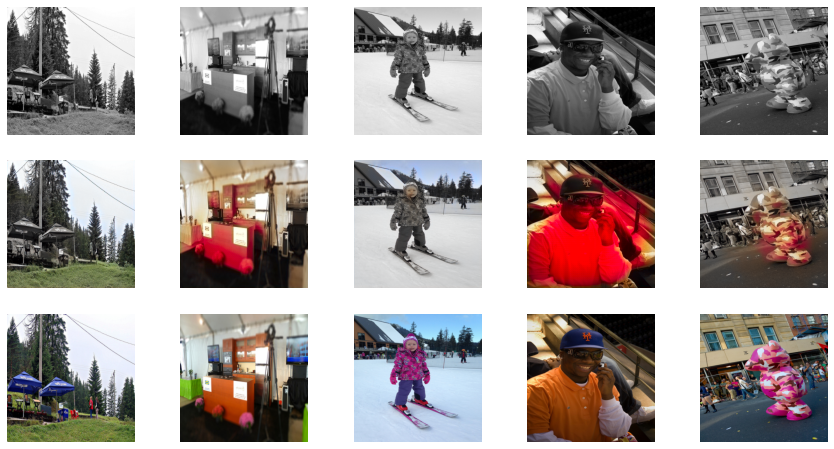

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/250
loss_D_fake: 0.56937
loss_D_real: 0.56354
loss_D: 0.56645
loss_G_GAN: 1.20084
loss_G_L1: 7.82245
loss_G: 9.02329


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


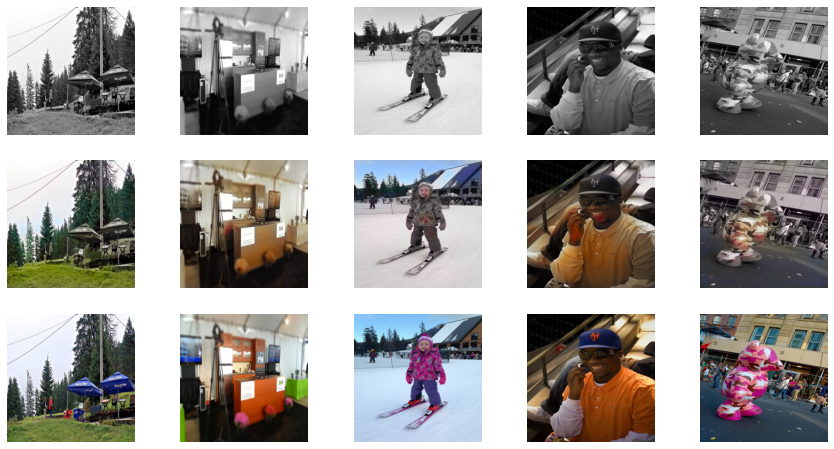

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/250
loss_D_fake: 0.59403
loss_D_real: 0.59756
loss_D: 0.59579
loss_G_GAN: 1.09635
loss_G_L1: 7.78242
loss_G: 8.87877


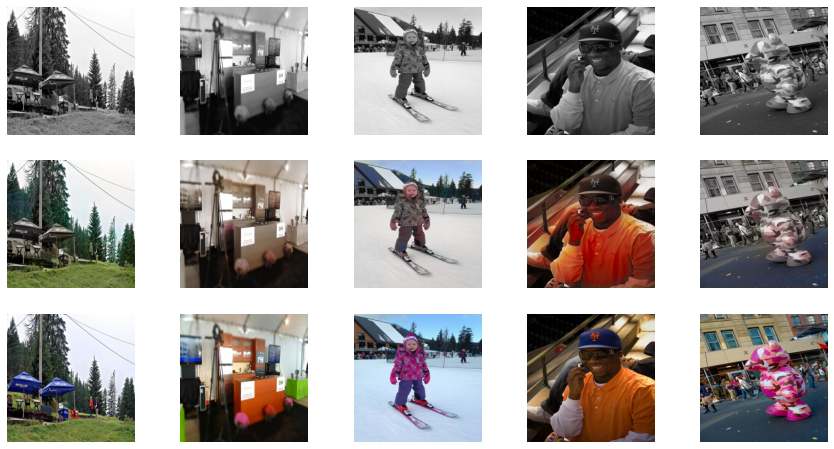

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/250
loss_D_fake: 0.57696
loss_D_real: 0.59415
loss_D: 0.58555
loss_G_GAN: 1.11234
loss_G_L1: 7.63559
loss_G: 8.74793


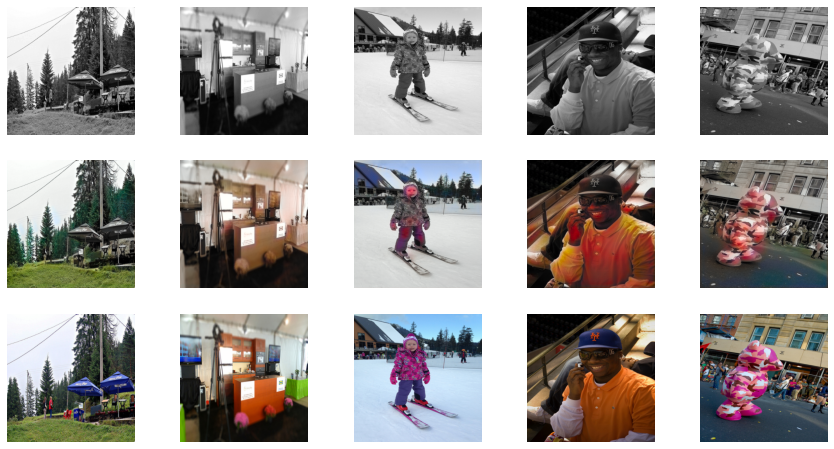

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/250
loss_D_fake: 0.58602
loss_D_real: 0.59028
loss_D: 0.58815
loss_G_GAN: 1.10167
loss_G_L1: 7.74388
loss_G: 8.84555


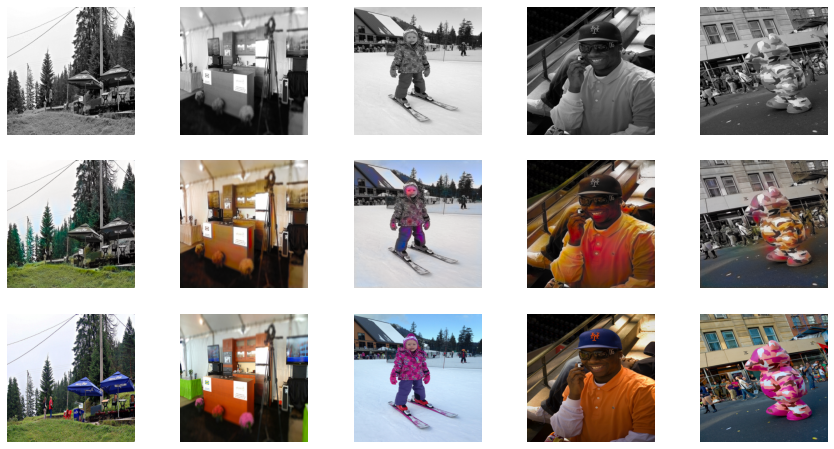

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/250
loss_D_fake: 0.58451
loss_D_real: 0.59716
loss_D: 0.59083
loss_G_GAN: 1.08659
loss_G_L1: 7.56575
loss_G: 8.65234


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


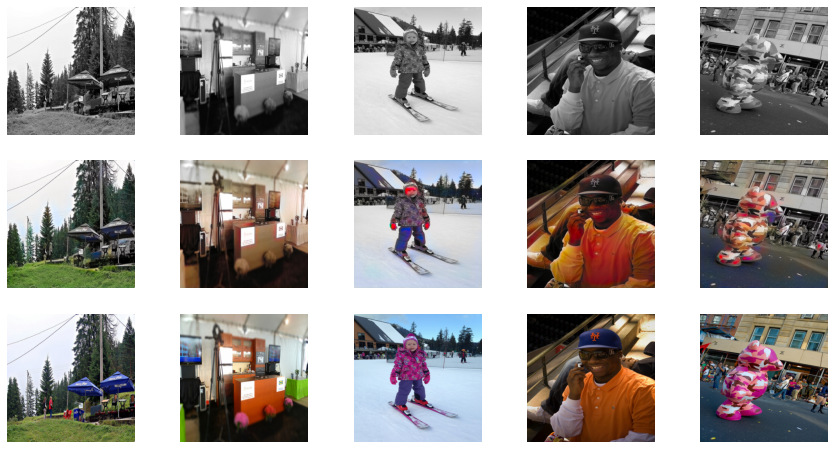

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/250
loss_D_fake: 0.57881
loss_D_real: 0.60310
loss_D: 0.59096
loss_G_GAN: 1.06806
loss_G_L1: 7.44008
loss_G: 8.50814


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


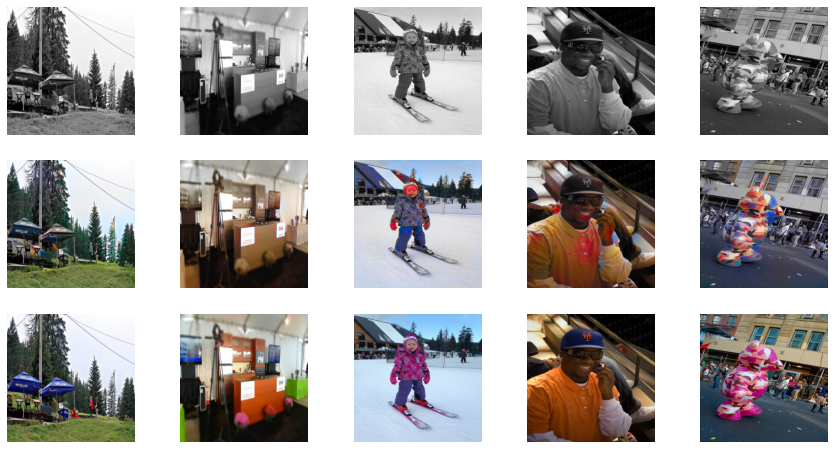

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/250
loss_D_fake: 0.59725
loss_D_real: 0.61578
loss_D: 0.60651
loss_G_GAN: 1.04673
loss_G_L1: 7.42100
loss_G: 8.46774


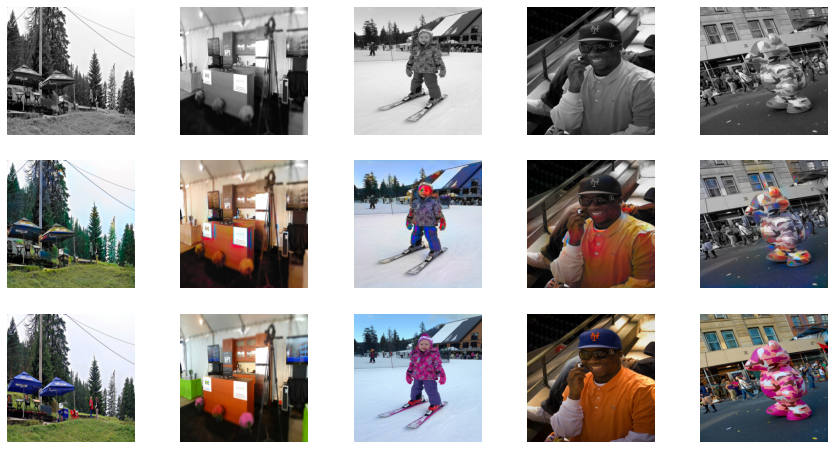

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/250
loss_D_fake: 0.59764
loss_D_real: 0.62005
loss_D: 0.60884
loss_G_GAN: 1.01989
loss_G_L1: 7.25522
loss_G: 8.27511


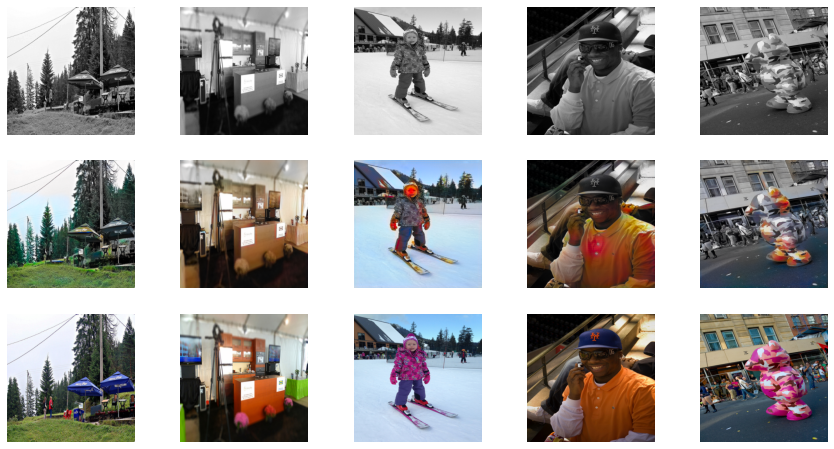

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/250
loss_D_fake: 0.60683
loss_D_real: 0.61936
loss_D: 0.61310
loss_G_GAN: 1.01293
loss_G_L1: 7.17951
loss_G: 8.19244


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


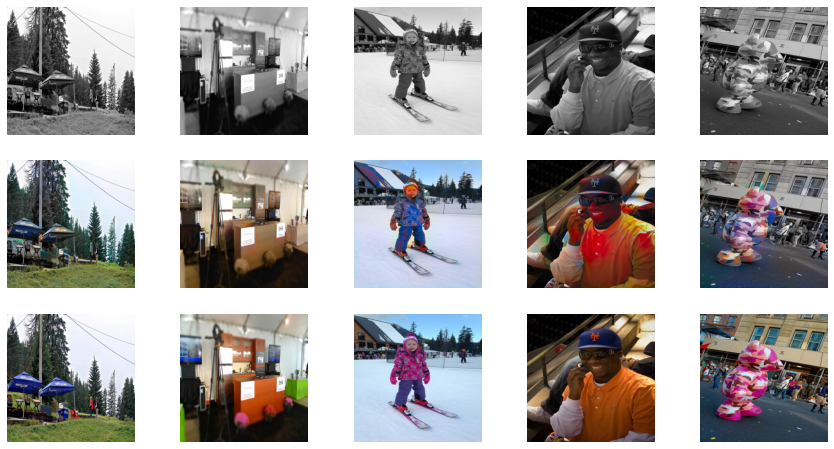

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/250
loss_D_fake: 0.61077
loss_D_real: 0.62851
loss_D: 0.61964
loss_G_GAN: 0.97677
loss_G_L1: 7.06350
loss_G: 8.04027


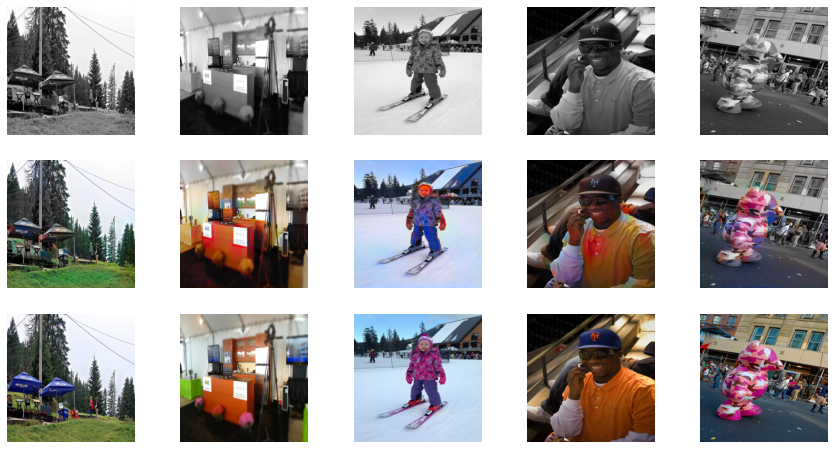

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/250
loss_D_fake: 0.61802
loss_D_real: 0.62471
loss_D: 0.62137
loss_G_GAN: 0.96623
loss_G_L1: 6.88644
loss_G: 7.85267


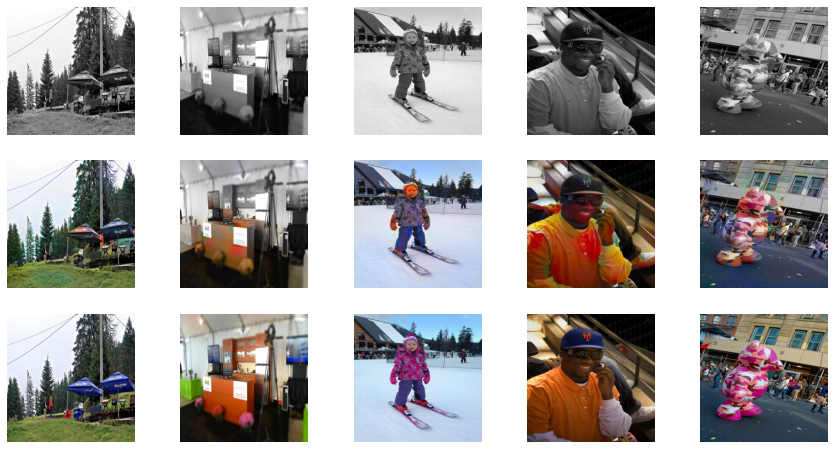

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/250
loss_D_fake: 0.61491
loss_D_real: 0.63247
loss_D: 0.62369
loss_G_GAN: 0.95894
loss_G_L1: 6.78021
loss_G: 7.73915


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


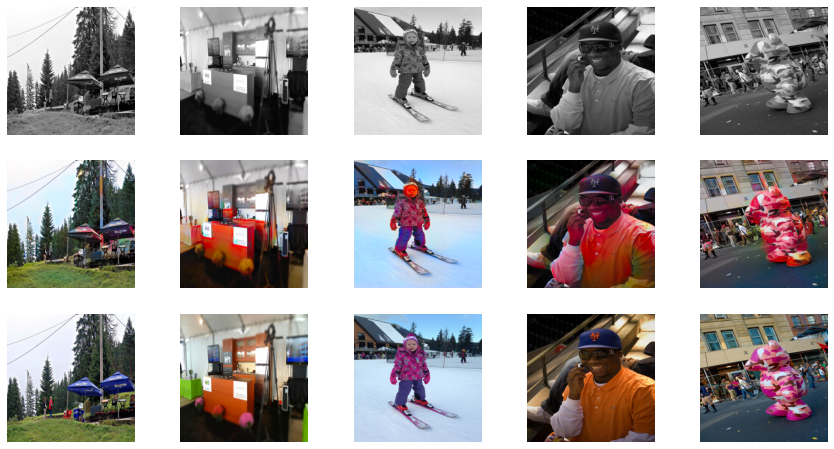

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/250
loss_D_fake: 0.61335
loss_D_real: 0.62488
loss_D: 0.61911
loss_G_GAN: 0.95669
loss_G_L1: 6.68067
loss_G: 7.63737


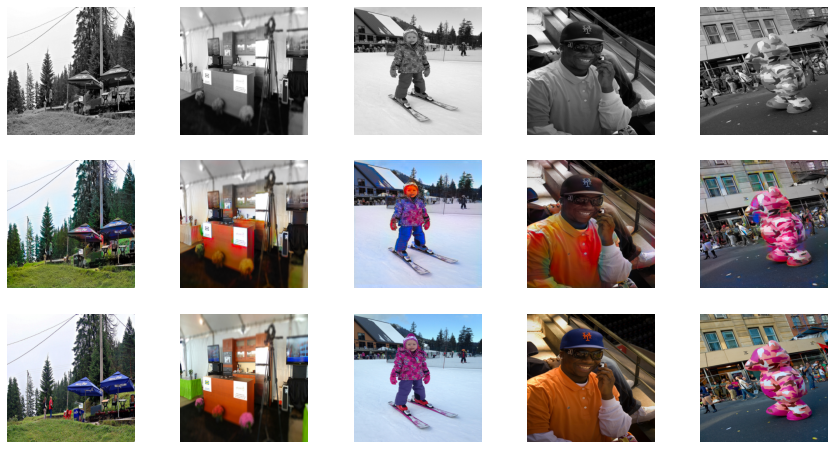

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/250
loss_D_fake: 0.62085
loss_D_real: 0.63437
loss_D: 0.62761
loss_G_GAN: 0.93788
loss_G_L1: 6.51123
loss_G: 7.44910


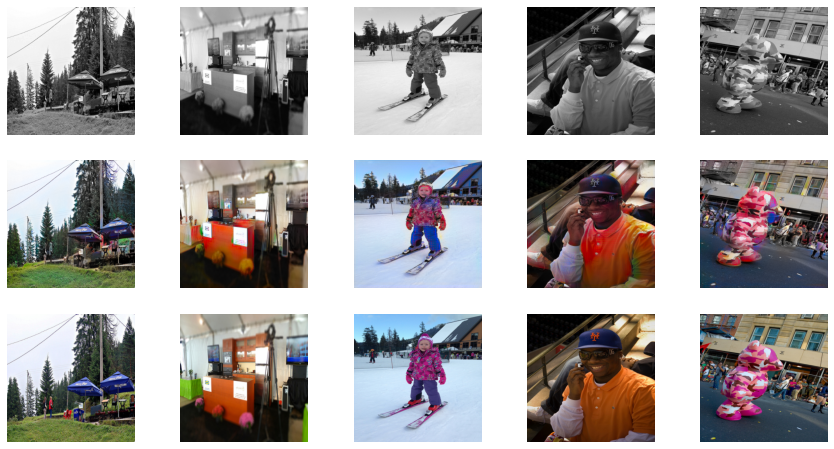

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/250
loss_D_fake: 0.61816
loss_D_real: 0.63824
loss_D: 0.62820
loss_G_GAN: 0.92833
loss_G_L1: 6.40643
loss_G: 7.33476


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


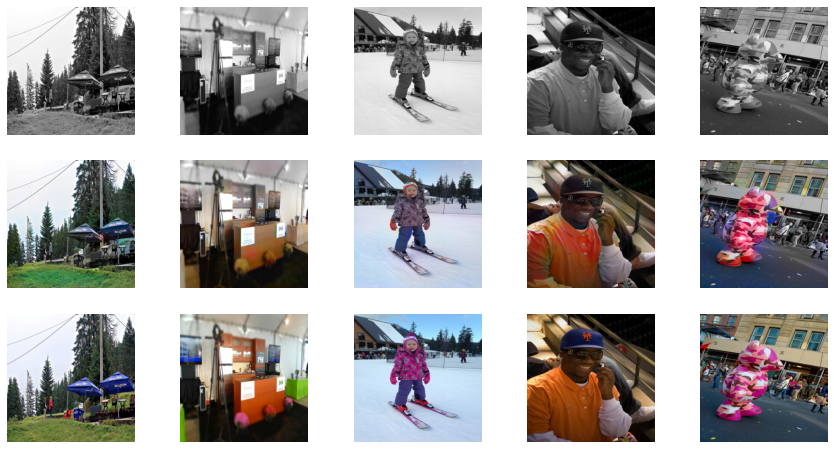

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/250
loss_D_fake: 0.62715
loss_D_real: 0.64430
loss_D: 0.63572
loss_G_GAN: 0.92745
loss_G_L1: 6.25978
loss_G: 7.18723


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


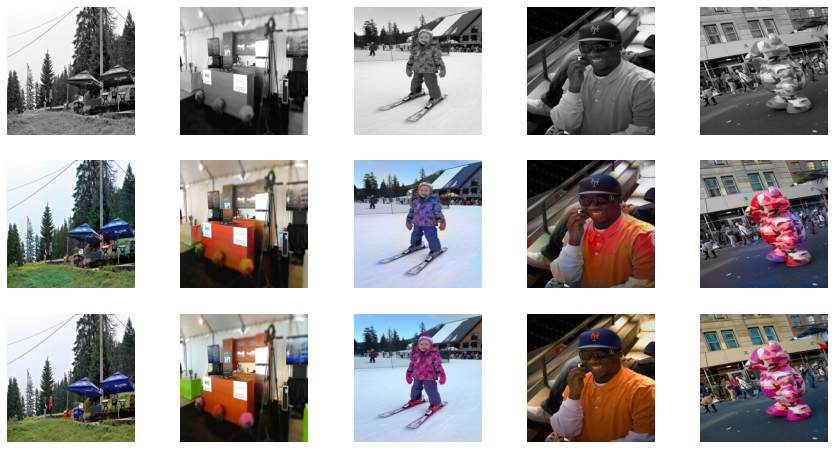

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/250
loss_D_fake: 0.63034
loss_D_real: 0.63992
loss_D: 0.63513
loss_G_GAN: 0.90923
loss_G_L1: 6.15446
loss_G: 7.06369


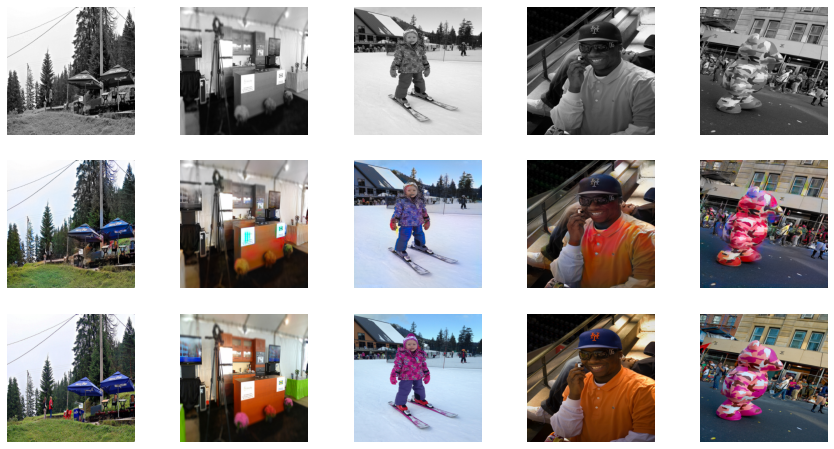

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 19/20
Iteration 200/250
loss_D_fake: 0.63579
loss_D_real: 0.64241
loss_D: 0.63910
loss_G_GAN: 0.90575
loss_G_L1: 5.99992
loss_G: 6.90568


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


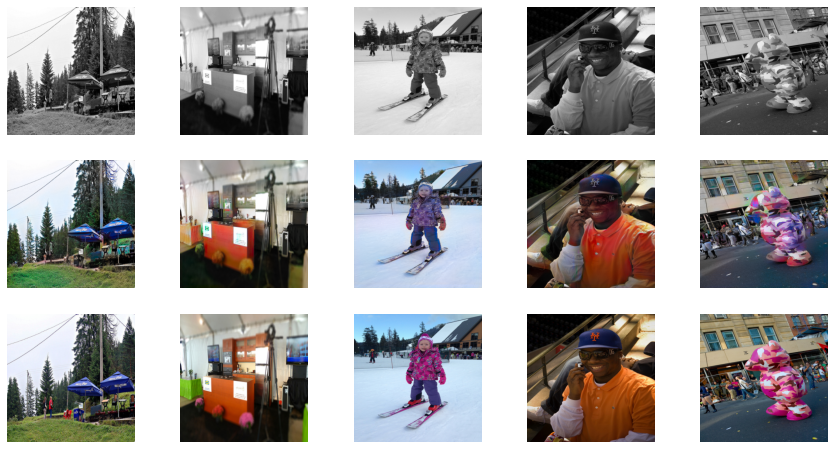

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 20/20
Iteration 200/250
loss_D_fake: 0.63442
loss_D_real: 0.64528
loss_D: 0.63985
loss_G_GAN: 0.89723
loss_G_L1: 5.88712
loss_G: 6.78434


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


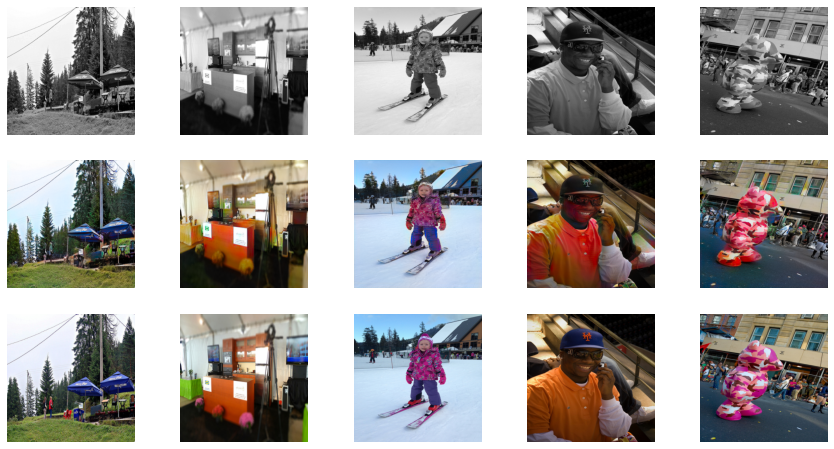

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
train_model(model, train_dl, 20)

Here I'm first loading the saved weights for the generator (which have been saved in the previous section) and then I'm using this model as the generator in our MainModel class which prevents it from randomly initializing the generator. Then we train the model for 10 to 20 epochs.

# Calcuting the sum of parameters in the Generator and Discriminator

In [ ]:
print("Generator Parameters:",sum(p.numel() for p in net_G.parameters() if p.requires_grad))
print("Discriminator Parameters:",sum(p.numel() for p in net_G.parameters() if p.requires_grad))

Generator Parameters: 31099672
Discriminator Parameters: 31099672


# Inception Score

Inception Score (IS) is an objective metric for evaluating the quality of generated images, specifically synthetic images output by generative adversarial network models. It uses the classification probabilities provided by a pre-trained Inceptionv3 Model to measure performance of a GAN.

In [ ]:
# calculate the inception score for p(y|x)
def calculate_inception_score(p_yx, eps=1E-16):
	# calculate p(y)
	p_y = expand_dims(p_yx.mean(axis=0), 0)
	# kl divergence for each image
	kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
	# sum over classes
	sum_kl_d = kl_d.sum(axis=1)
	# average over images
	avg_kl_d = mean(sum_kl_d)
	# undo the logs
	is_score = exp(avg_kl_d)
	return is_score

In [ ]:
# calculate inception score in numpy
from numpy import asarray
from numpy import expand_dims
from numpy import log
from numpy import mean
from numpy import exp
 
# calculate the inception score for p(y|x)
def calculate_inception_score(p_yx, eps=1E-16):
	# calculate p(y)
	p_y = expand_dims(p_yx.mean(axis=0), 0)
	# kl divergence for each image
	kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
	# sum over classes
	sum_kl_d = kl_d.sum(axis=1)
	# average over images
	avg_kl_d = mean(sum_kl_d)
	# undo the logs
	is_score = exp(avg_kl_d)
	return is_score
 
# conditional probabilities for high quality images
p_yx = asarray([[1.0, 0.0, 0.0], [0.0, 1.0, 0.0], [0.0, 0.0, 1.0]])
score = calculate_inception_score(p_yx)
print(score)

2.999999999999999


In [ ]:
# conditional probabilities for low quality images
p_yx = asarray([[0.33, 0.33, 0.33], [0.33, 0.33, 0.33], [0.33, 0.33, 0.33]])
score = calculate_inception_score(p_yx)
print(score)

1.0


We are using the Inception Score metric to test and evaluate the generative model in our setting. We implement the Inception score in Numpy library. The Inception score uses our pre-trained model for image classification to classify the generated images. 
The score seeks to capture two properties of a collection of generated images:

1. Image Quality. Do images look like a specific object?
2. Image Diversity. Is a wide range of objects generated?
The lower the value of the IS implies better results. The minimun score is 1.0 as we see, which is our probablity distribution value.